# Introduction
## Note: This project contains spoilers for DDLC

Hello, I'm nopynospy and I love Doki Doki Literature Club. I stumbled across Monika After Story Mod for the game and the fans are adding additional dialogues for the character, Monika. Guidelines are provided for dialogue contributors, but I feel that maybe I can make it more specifics by obtaining insights from the original scripts using some basic natural language processing. Luckily, someone has extracted all the game files in this repo, https://github.com/judge2020/DokiDoki-Decompile.

Well, someone else may want to use it for the mods that focuses on other characters, so I may as well run the analysis on all the characters.

# Data Preprocessing and Engineering

In this section, I will extract the scripts from the game files and do some data cleaning. I will also generate some new data.

In [1]:
# Get the list of files starting from script- and has extension .rpy
import os

scripts_list = []
for file in os.listdir("scripts.rpa"):
    if file.endswith(".rpy") and file.startswith("script-"):
        scripts_list.append(file)

scripts_list

['script-ch0.rpy',
 'script-ch1.rpy',
 'script-ch10.rpy',
 'script-ch2.rpy',
 'script-ch20.rpy',
 'script-ch21.rpy',
 'script-ch22.rpy',
 'script-ch23.rpy',
 'script-ch3.rpy',
 'script-ch30.rpy',
 'script-ch4.rpy',
 'script-ch40.rpy',
 'script-ch5.rpy',
 'script-exclusives-natsuki.rpy',
 'script-exclusives-sayori.rpy',
 'script-exclusives-yuri.rpy',
 'script-exclusives2-natsuki.rpy',
 'script-exclusives2-yuri.rpy',
 'script-poemgame.rpy',
 'script-poemresponses.rpy',
 'script-poemresponses2.rpy']

In [2]:
# Create a function that extracts lines from different character using regular expression.
# Also, remove punctuations like comma and period. But, I keep ellipsis (...), question and exclamation marks.
import re

LINE_REGEX = [
                {"Sayori": r'    s.* "(?:[^\\"]|\\\\|\\")*"'},
                {"MC": r'    mc.* "(?:[^\\"]|\\\\|\\")*"'},
                {"Yuri": r'    y.* "(?:[^\\"]|\\\\|\\")*"'},
                {"Natsuki": r'    n.* "(?:[^\\"]|\\\\|\\")*"'},
                {"Monika": r'    m.* "(?:[^\\"]|\\\\|\\")*"'}
            ]

CHARS_TO_REMOVE = ["'", '"', ",", "[", "]", "{", "}"]

def get_char_line(patt, text):
    matches = re.findall(patt, text)
    for i, match in enumerate(matches):
        matches[i] = re.sub(r' +(s|mc|y|n|m)( [0-9][a-z]*)* ', '', match )
        for c in CHARS_TO_REMOVE:
            matches[i] = matches[i].replace(c, '')

    return matches

In [3]:
# Create an empty dataframe

import pandas as pd

df = pd.DataFrame(columns = ['file', 'name', 'line'])

In [4]:
# Open all of the script file and populate the dataframe with filename, character name and line

for script in scripts_list:
    with open(os.path.join("scripts.rpa", script), 'r') as file:
        script_raw = file.read()
        for regex in LINE_REGEX:
            for result in get_char_line(list(regex.values())[0], script_raw):
                df = df.append({'file' : script,
                                'name' : list(regex.keys())[0],
                                'line' : result},
                    ignore_index = True)

df

,file,name,line
0,script-ch0.rpy,Sayori,Heeeeeeeyyy!!
1,script-ch0.rpy,Sayori,Haaahhh...haaahhh...
2,script-ch0.rpy,Sayori,I overslept again!
3,script-ch0.rpy,Sayori,But I caught you this time!
4,script-ch0.rpy,Sayori,Eeehhhhh you say that like you were thinking a...
...,...,...,...
11053,script-poemresponses2.rpy,Monika,But I guess thats why I had to explain it all ...
11054,script-poemresponses2.rpy,Monika,So I think if you keep your distance that woul...
11055,script-poemresponses2.rpy,Monika,While youre at it dont be shy to spend a littl...
11056,script-poemresponses2.rpy,Monika,To put it lightly I at least have it together ...


In [5]:
# Retrieve the tokens from the lines by removing stopwords like I, he to only keep words with more meaning

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

STOP_WORDS = set(stopwords.words('english'))

def get_tokens(sent):
    sent = sent.lower()
    word_tokens = word_tokenize(sent)
    filtered_sentence = []
    for w in word_tokens:
        if w not in STOP_WORDS and w != '.':
            filtered_sentence.append(w)
    return filtered_sentence

In [6]:
df['tokens'] = df['line'].apply(get_tokens)

df

,file,name,line,tokens
0,script-ch0.rpy,Sayori,Heeeeeeeyyy!!,"[heeeeeeeyyy, !, !]"
1,script-ch0.rpy,Sayori,Haaahhh...haaahhh...,"[haaahhh, ..., haaahhh, ...]"
2,script-ch0.rpy,Sayori,I overslept again!,"[overslept, !]"
3,script-ch0.rpy,Sayori,But I caught you this time!,"[caught, time, !]"
4,script-ch0.rpy,Sayori,Eeehhhhh you say that like you were thinking a...,"[eeehhhhh, say, like, thinking, ignoring, !]"
...,...,...,...,...
11053,script-poemresponses2.rpy,Monika,But I guess thats why I had to explain it all ...,"[guess, thats, explain, ...]"
11054,script-poemresponses2.rpy,Monika,So I think if you keep your distance that woul...,"[think, keep, distance, would, probably, best]"
11055,script-poemresponses2.rpy,Monika,While youre at it dont be shy to spend a littl...,"[youre, dont, shy, spend, little, time, ...]"
11056,script-poemresponses2.rpy,Monika,To put it lightly I at least have it together ...,"[put, lightly, least, together, head, ..., kno..."


In [7]:
# Uses the re module to count number of words in a line.
def count_words(string):
    return len(re.findall(r'\w+', string))

df['words_num'] = df['line'].apply(count_words)

In [8]:
# Compute polarity and subjectivity of each line
# Subjectivity: the higher the more subjective is a statement
# Polarity: the higher the more positive is a statement

from textblob import TextBlob

df[['polarity', 'subjectivity']] = df['line'].apply(lambda Text: pd.Series(TextBlob(Text).sentiment))

df

,file,name,line,tokens,words_num,polarity,subjectivity
0,script-ch0.rpy,Sayori,Heeeeeeeyyy!!,"[heeeeeeeyyy, !, !]",1,0.0000,0.0
1,script-ch0.rpy,Sayori,Haaahhh...haaahhh...,"[haaahhh, ..., haaahhh, ...]",2,0.0000,0.0
2,script-ch0.rpy,Sayori,I overslept again!,"[overslept, !]",3,0.0000,0.0
3,script-ch0.rpy,Sayori,But I caught you this time!,"[caught, time, !]",6,0.0000,0.0
4,script-ch0.rpy,Sayori,Eeehhhhh you say that like you were thinking a...,"[eeehhhhh, say, like, thinking, ignoring, !]",11,0.0000,0.0
...,...,...,...,...,...,...,...
11053,script-poemresponses2.rpy,Monika,But I guess thats why I had to explain it all ...,"[guess, thats, explain, ...]",13,0.0000,0.0
11054,script-poemresponses2.rpy,Monika,So I think if you keep your distance that woul...,"[think, keep, distance, would, probably, best]",15,1.0000,0.3
11055,script-poemresponses2.rpy,Monika,While youre at it dont be shy to spend a littl...,"[youre, dont, shy, spend, little, time, ...]",15,-0.0625,0.5
11056,script-poemresponses2.rpy,Monika,To put it lightly I at least have it together ...,"[put, lightly, least, together, head, ..., kno...",22,-0.3000,0.4


In [9]:
# Compute lexical diversity of each line.
# Lexcial diversity refers to how many unique words in a line
from lexical_diversity import lex_div as ld

def count_ld(string):
    flt = ld.flemmatize(string)
    return(ld.ttr(flt))

df['lex_div'] = df['line'].apply(count_ld)

df

,file,name,line,tokens,words_num,polarity,subjectivity,lex_div
0,script-ch0.rpy,Sayori,Heeeeeeeyyy!!,"[heeeeeeeyyy, !, !]",1,0.0000,0.0,1.000000
1,script-ch0.rpy,Sayori,Haaahhh...haaahhh...,"[haaahhh, ..., haaahhh, ...]",2,0.0000,0.0,1.000000
2,script-ch0.rpy,Sayori,I overslept again!,"[overslept, !]",3,0.0000,0.0,1.000000
3,script-ch0.rpy,Sayori,But I caught you this time!,"[caught, time, !]",6,0.0000,0.0,1.000000
4,script-ch0.rpy,Sayori,Eeehhhhh you say that like you were thinking a...,"[eeehhhhh, say, like, thinking, ignoring, !]",11,0.0000,0.0,0.909091
...,...,...,...,...,...,...,...,...
11053,script-poemresponses2.rpy,Monika,But I guess thats why I had to explain it all ...,"[guess, thats, explain, ...]",13,0.0000,0.0,0.846154
11054,script-poemresponses2.rpy,Monika,So I think if you keep your distance that woul...,"[think, keep, distance, would, probably, best]",15,1.0000,0.3,1.000000
11055,script-poemresponses2.rpy,Monika,While youre at it dont be shy to spend a littl...,"[youre, dont, shy, spend, little, time, ...]",15,-0.0625,0.5,1.000000
11056,script-poemresponses2.rpy,Monika,To put it lightly I at least have it together ...,"[put, lightly, least, together, head, ..., kno...",22,-0.3000,0.4,0.857143


# Data Exploration and Visualization

In this section, I use plots to explore the data for more insights.

C:\Users\tanke\.virtualenvs\DokiDoki-Decompile-qxPhnkR6\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


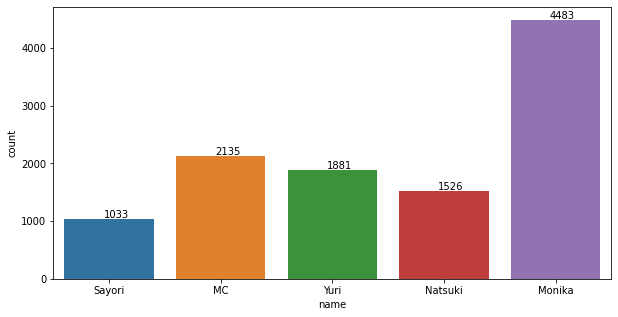

In [10]:
# Plot the number of lines for each character
import seaborn as sns
import matplotlib.pyplot as plt

fig = plt.figure(figsize = (10, 5))

count_plot = sns.countplot(df['name'])

#This display the values on top of the bars
for p in count_plot.patches:
        count_plot.annotate('{}'.format(p.get_height()), (p.get_x()+.35, p.get_height()+20))

Monika speaks the most, due to her monologues. The MC ranks second, as he did not die. Sayori is the earliest to die, so her lines are the least.

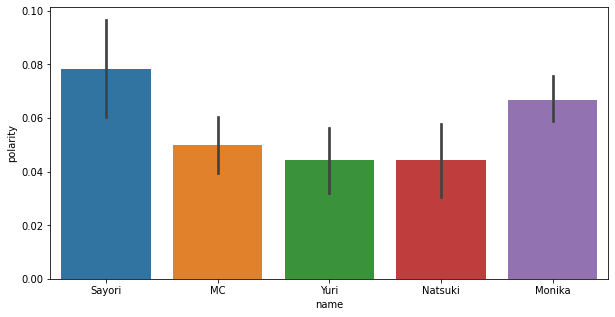

In [11]:
# Plot the polarity of each character
fig = plt.figure(figsize = (10, 5))

ax = sns.barplot(x='name', y='polarity', data=df)

Sayori and Monika have the highest polarity. Despite Sayori's depression, she got the highest. Yuri and Natsuki are the lowest, probably because they argue a lot. The MC is well, dense, so it makes sense that he is in the middle.

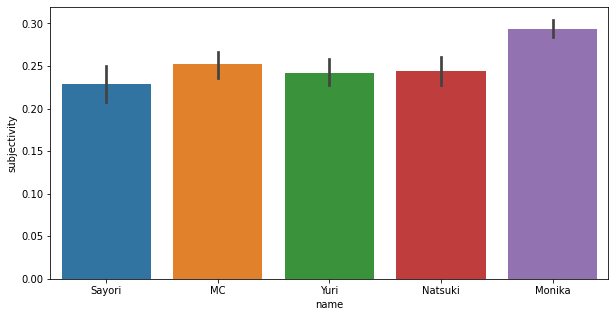

In [12]:
# Plot the subjectivity of each character

fig = plt.figure(figsize = (10, 5))

ax = sns.barplot(x='name', y='subjectivity', data=df)

Monika has the highest subjectivity, probably because of her constant monologues in the climax of the plot.

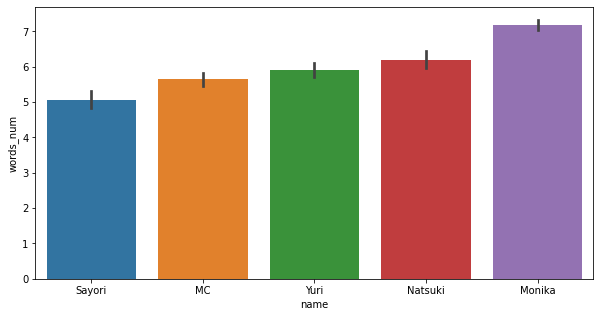

In [13]:
# Plot the word numbers of each character

fig = plt.figure(figsize = (10, 5))

ax = sns.barplot(x='name', y='words_num', data=df)

Monika has the highest number of words, unsurprisingly. Sayori has lowest, is it related to her depression though? Yuri is very quite, but even she has more words per line than the both Sayori and the dense MC.

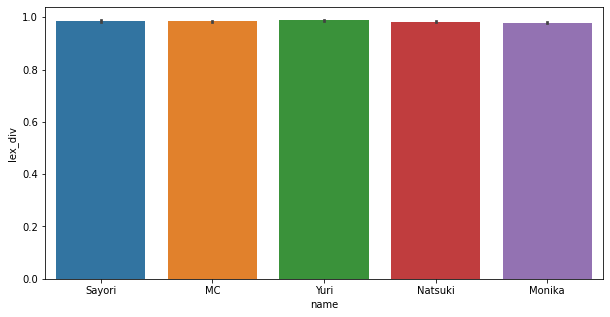

In [14]:
# Plot the Lexical diversity of each character

fig = plt.figure(figsize = (10, 5))

ax = sns.barplot(x='name', y='lex_div', data=df)

All od the characters have high lexical diversity, but Monika actually has lowest.

In [15]:
# Count the tokens
from collections import Counter

def tokens_to_counter(name):
    filter_df = df.loc[df['name'] == name]
    lists = filter_df['tokens'].to_list()
    return Counter([item for sublist in lists for item in sublist])

In [16]:
# Generate word cloud, seed is set as 69, because why not?
from wordcloud import WordCloud

SEED = 69

def counter_to_wordcloud(counter):
    wordcloud = WordCloud(width = 1000, height = 500, random_state=SEED).generate_from_frequencies(counter)

    plt.figure(figsize=(15,8))
    plt.imshow(wordcloud)
    plt.axis("off")

## Sayori's most frequent words

In [17]:
sayori_counter = tokens_to_counter("Sayori")
sayori_counter.most_common(100)

[('...', 385),
 ('!', 309),
 ('?', 166),
 ('player', 75),
 ('im', 60),
 ('like', 56),
 ('really', 55),
 ('thats', 49),
 ('dont', 49),
 ('know', 46),
 ('youre', 28),
 ('ehehe', 27),
 ('well', 25),
 ('get', 25),
 ('--', 25),
 ('ehehe~', 24),
 ('everyone', 24),
 ('eh', 23),
 ('right', 23),
 ('happy', 22),
 ('even', 21),
 ('good', 21),
 ('okay', 21),
 ('would', 20),
 ('want', 19),
 ('club', 19),
 ('make', 19),
 ('monika', 19),
 ('think', 19),
 ('much', 19),
 ('time', 18),
 ('little', 18),
 ('come', 18),
 ('poem', 18),
 ('fun', 16),
 ('go', 16),
 ('best', 15),
 ('na', 15),
 ('one', 14),
 ('see', 14),
 ('gon', 14),
 ('say', 13),
 ('way', 13),
 ('sorry', 13),
 ('feelings', 13),
 ('wouldnt', 13),
 ('mean', 12),
 ('guess', 12),
 ('yeah', 12),
 ('natsuki', 12),
 ('poems', 12),
 ('nice', 12),
 ('thing', 12),
 ('ah', 12),
 ('always', 11),
 ('something', 11),
 ('ahaha', 11),
 ('understand', 11),
 ('maybe', 11),
 ('things', 11),
 ('everything', 10),
 ('hey', 10),
 ('cant', 10),
 ('people', 10),
 ('e

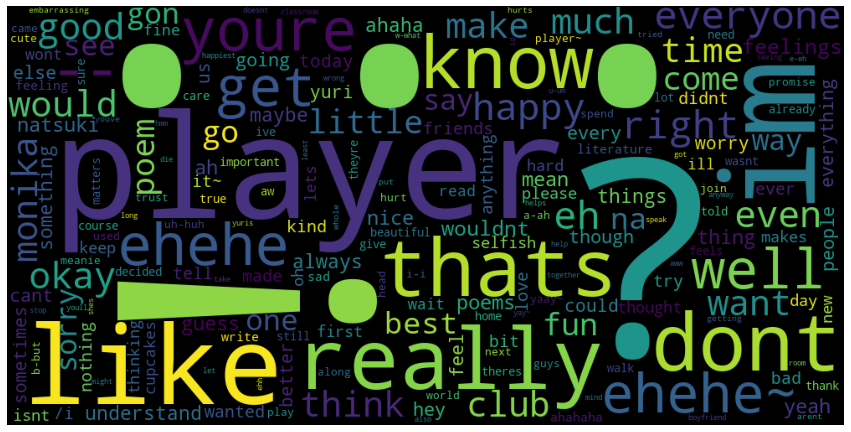

In [18]:
counter_to_wordcloud(sayori_counter)

Sayori is the MC's childhood friend after all and has depression, so the MC (player) naturally appears a lot in her lines. Interestingly, Yuri and Natsuki both appeared exactly 12 times. Sayori also has more exclamations than questions.

## MC's most frequent words

In [19]:
mc_counter = tokens_to_counter("MC")
mc_counter.most_common(100)

[('...', 886),
 ('?', 480),
 ('!', 156),
 ('ah', 143),
 ('yeah', 117),
 ('well', 114),
 ('dont', 107),
 ('--', 107),
 ('thats', 105),
 ('like', 105),
 ('sayori', 104),
 ('im', 99),
 ('really', 96),
 ('guess', 91),
 ('youre', 79),
 ('eh', 70),
 ('yuri', 63),
 ('right', 60),
 ('think', 56),
 ('ill', 54),
 ('know', 54),
 ('see', 53),
 ('mean', 53),
 ('alright', 49),
 ('didnt', 47),
 ('even', 45),
 ('something', 44),
 ('little', 43),
 ('anything', 43),
 ('would', 41),
 ('kind', 41),
 ('sure', 40),
 ('say', 39),
 ('club', 39),
 ('get', 39),
 ('good', 38),
 ('natsuki', 37),
 ('way', 36),
 ('time', 35),
 ('one', 33),
 ('want', 32),
 ('fine', 32),
 ('sorry', 32),
 ('much', 31),
 ('go', 30),
 ('always', 30),
 ('make', 29),
 ('anyway', 28),
 ('look', 27),
 ('going', 25),
 ('could', 25),
 ('things', 25),
 ('ahaha', 25),
 ('need', 24),
 ('read', 24),
 ('never', 24),
 ('maybe', 23),
 ('cant', 23),
 ('still', 22),
 ('thing', 22),
 ('friends', 22),
 ('poem', 22),
 ('said', 21),
 ('reading', 21),
 ('m

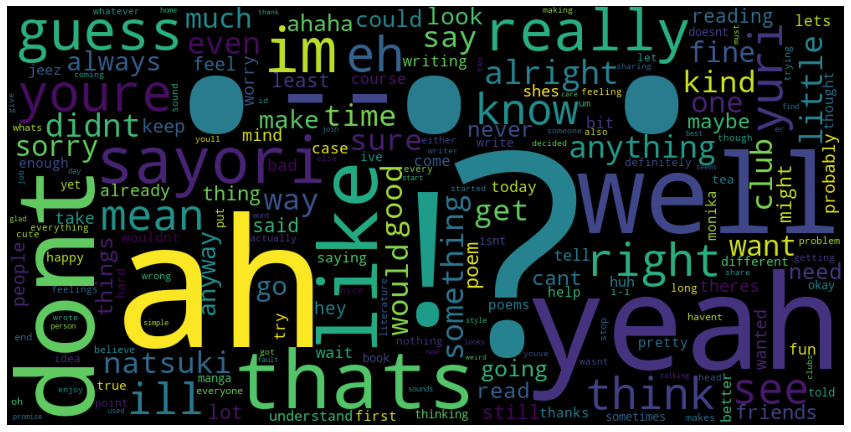

In [20]:
counter_to_wordcloud(mc_counter)

The MC and Sayori are childhood friends, despite her shortest screen time, Sayori appears the most in the MC's lines. The frequency is then followed by Yuri, Natsuki and Monika. The MC asks a lot questions very frequently too.

## Yuri's most frequent words

In [21]:
yuri_counter = tokens_to_counter("Yuri")
yuri_counter.most_common(100)

[('...', 1067),
 ('?', 259),
 ('!', 208),
 ('im', 116),
 ('well', 98),
 ('like', 93),
 ('dont', 89),
 ('player', 88),
 ('really', 69),
 ('thats', 66),
 ('ah', 60),
 ('--', 60),
 ('something', 56),
 ('know', 54),
 ('think', 42),
 ('sorry', 41),
 ('would', 41),
 ('little', 40),
 ('feel', 39),
 ('make', 38),
 ('things', 36),
 ('youre', 35),
 ('right', 35),
 ('see', 34),
 ('writing', 33),
 ('time', 33),
 ('club', 31),
 ('even', 31),
 ('want', 31),
 ('natsuki', 30),
 ('way', 28),
 ('anything', 28),
 ('bit', 27),
 ('okay', 27),
 ('good', 26),
 ('eh', 26),
 ('ill', 26),
 ('monika', 26),
 ('read', 25),
 ('um', 25),
 ('didnt', 25),
 ('mean', 25),
 ('much', 24),
 ('get', 24),
 ('need', 24),
 ('people', 23),
 ('ive', 22),
 ('reading', 22),
 ('poem', 22),
 ('go', 22),
 ('i-i', 21),
 ('going', 21),
 ('us', 20),
 ('guess', 20),
 ('mind', 20),
 ('today', 20),
 ('nice', 19),
 ('tea', 19),
 ('lets', 19),
 ('take', 19),
 ('kind', 19),
 ('please', 19),
 ('say', 18),
 ('thing', 18),
 ('always', 17),
 ('co

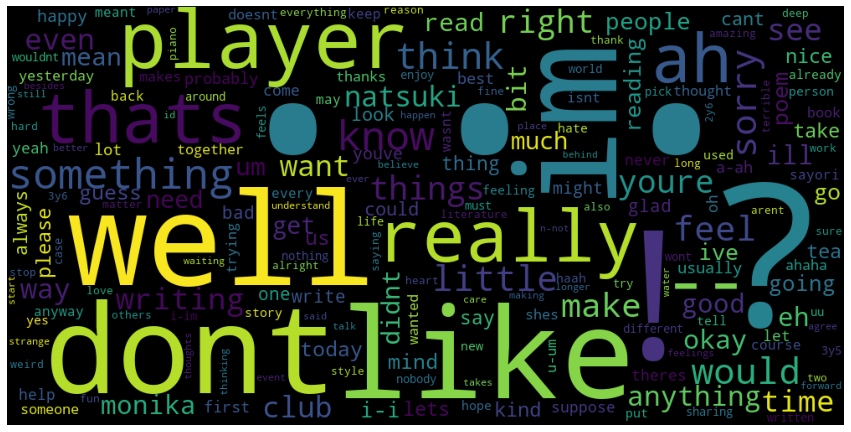

In [22]:
counter_to_wordcloud(yuri_counter)

Followed by MC, Natsuki is mentioned the most by Yuri, probably because they argue a lot. Sayori is not even in her most frequent 100 words, perhaps they are not close. Yuri asks than she proclaims. Yuri uses exclamation marks, almost five times more than she asks, likely due to her shy nature.

## Natsuki's most frequent words

In [23]:
natsuki_counter = tokens_to_counter("Natsuki")
natsuki_counter.most_common(100)

[('...', 513),
 ('!', 390),
 ('?', 299),
 ('like', 112),
 ('well', 88),
 ('really', 78),
 ('dont', 73),
 ('know', 66),
 ('youre', 66),
 ('im', 63),
 ('--', 59),
 ('one', 53),
 ('mean', 48),
 ('would', 40),
 ('something', 37),
 ('yeah', 37),
 ('anyway', 37),
 ('player', 36),
 ('yuri', 36),
 ('get', 34),
 ('think', 34),
 ('make', 34),
 ('didnt', 32),
 ('thats', 32),
 ('okay', 31),
 ('anything', 30),
 ('even', 29),
 ('right', 29),
 ('jeez', 29),
 ('good', 29),
 ('guess', 28),
 ('monika', 27),
 ('read', 27),
 ('say', 26),
 ('people', 26),
 ('better', 25),
 ('way', 24),
 ('want', 24),
 ('see', 24),
 ('going', 24),
 ('look', 24),
 ('gon', 24),
 ('na', 24),
 ('cant', 23),
 ('time', 23),
 ('trying', 22),
 ('poem', 21),
 ('little', 21),
 ('take', 20),
 ('come', 20),
 ('kind', 20),
 ('feel', 20),
 ('ill', 19),
 ('oh', 19),
 ('could', 19),
 ('ugh', 18),
 ('nice', 18),
 ('much', 18),
 ('need', 18),
 ('go', 18),
 ('club', 18),
 ('eh', 17),
 ('tell', 17),
 ('fine', 17),
 ('youll', 17),
 ('/i', 16),


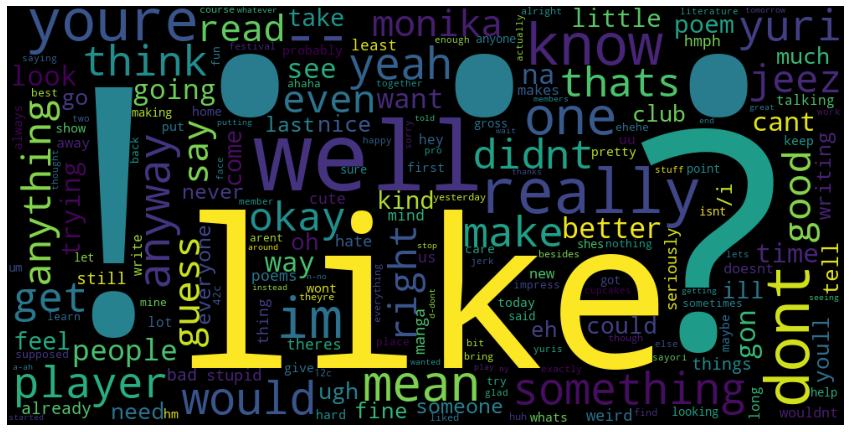

In [24]:
counter_to_wordcloud(natsuki_counter)

Natsuki is very similar to Yuri in some ways, despite being polar opposites. Followed by MC, Yuri is mentioned the most by Natsuki, probably because they argue a lot. Sayori is not even in her most frequent 100 words, perhaps they are not close. Natsuki proclaims than she asks. Unlike Yuri, Natsuki is quite blunt and she does not use that many ellipsis compared to others.

## Monika's most frequent words

In [25]:
monika_counter = tokens_to_counter("Monika")
monika_counter.most_common(100)

[('...', 1619),
 ('?', 894),
 ('!', 487),
 ('like', 299),
 ('really', 260),
 ('im', 255),
 ('dont', 244),
 ('well', 206),
 ('thats', 201),
 ('know', 191),
 ('youre', 184),
 ('ah', 176),
 ('think', 163),
 ('guess', 150),
 ('yeah', 146),
 ('right', 135),
 ('sayori', 128),
 ('--', 127),
 ('even', 125),
 ('something', 123),
 ('yuri', 123),
 ('kind', 119),
 ('time', 115),
 ('mean', 112),
 ('get', 110),
 ('player', 109),
 ('little', 107),
 ('would', 107),
 ('club', 101),
 ('way', 99),
 ('natsuki', 94),
 ('ahaha', 93),
 ('didnt', 92),
 ('anything', 92),
 ('much', 91),
 ('want', 90),
 ('make', 90),
 ('see', 90),
 ('good', 90),
 ('anyway', 86),
 ('ill', 85),
 ('eh', 85),
 ('things', 84),
 ('could', 81),
 ('people', 80),
 ('feel', 80),
 ('go', 80),
 ('okay', 79),
 ('one', 79),
 ('sure', 77),
 ('sorry', 76),
 ('poem', 66),
 ('say', 65),
 ('everyone', 65),
 ('always', 65),
 ('maybe', 63),
 ('never', 61),
 ('alright', 58),
 ('going', 54),
 ('lot', 53),
 ('still', 52),
 ('need', 51),
 ('might', 50),

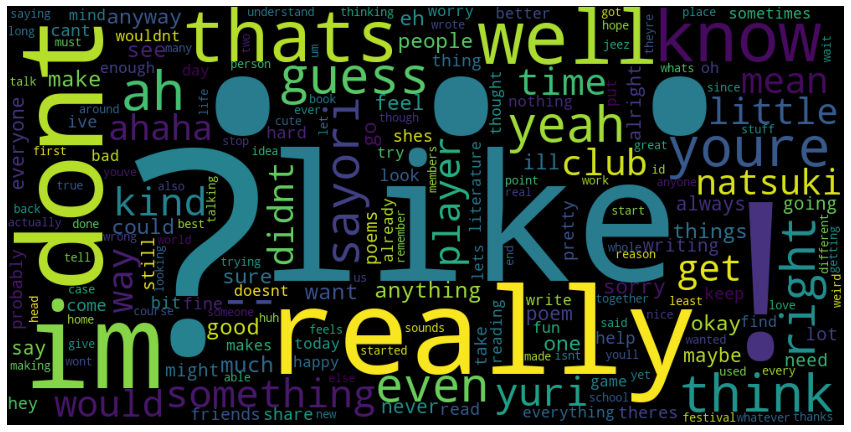

In [26]:
counter_to_wordcloud(monika_counter)

Surprisingly, Monika is the only girl that does not mention the MC the most. On the other hand, she actually mentions Sayori the most. She asks almost two times the number she exclaims.

# Data Modelling

In this section, I will use clustering on each character to get the number of categories in their lines. I will also compare the clusters.

In [27]:
# Sklearn library is used for the clustering and tfidf (term frequency–inverse document frequency)
# Silhoutte score and the elbow method will provide an idea as to how many clusters are there
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import silhouette_score
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans

tfIdfVectorizer=TfidfVectorizer(use_idf=True)

# Filter the dataframe by character name
def filter_df_name(name):
    return df.loc[df['name'] == name]

# Compute TFIDF from tokens, instead of original lines, because they contain stop words
def tokens_to_tfidf(df):
    tfIdf = tfIdfVectorizer.fit_transform(df['line'])
    return tfIdf

sil = []
inertias = []
kmax = 10

# Elbow method to get optimal number of clusters
def plot_elbow(tfidf):
    global sil, inertias
    sil = []
    inertias = []
    for k in range(2, kmax+1):
        kmeans = KMeans(n_clusters = k).fit(tfidf)
        labels = kmeans.labels_
        sil.append(silhouette_score(tfidf, labels, metric = 'euclidean'))
        inertias.append(kmeans.inertia_)

    plt.plot(range(2, kmax+1), inertias)
    plt.title('Elbow method')
    plt.xlabel('No of clusters')
    plt.ylabel('Error')
    plt.show()

# Silouette score to get optimal number of clusters
def plot_silhouette():
    plt.plot(range(2, kmax+1), sil)
    plt.xlabel('No of clusters')
    plt.ylabel('Silhouette score')
    plt.show()

# Based on the optimal number of clusters, categorize the lines
def tfidf_cluster(tfidf, n, df):
    km = KMeans(n_clusters=n, random_state=SEED)
    km.fit(tfidf)
    df['Cluster'] = km.labels_.tolist()

# Sayori's clusters

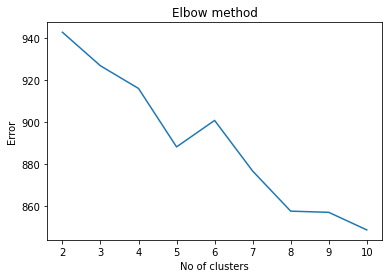

In [28]:
sayori_df = filter_df_name("Sayori")
sayori_tfidf = tokens_to_tfidf(sayori_df)
plot_elbow(sayori_tfidf)

Probably 5, 8 is too high

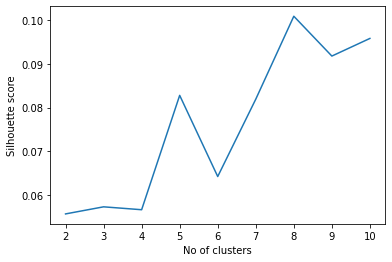

In [29]:
plot_silhouette()

5, because the increment from 4 to 5 is a lot

C:\Users\tanke\AppData\Local\Temp/ipykernel_8436/1405964549.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Cluster'] = km.labels_.tolist()


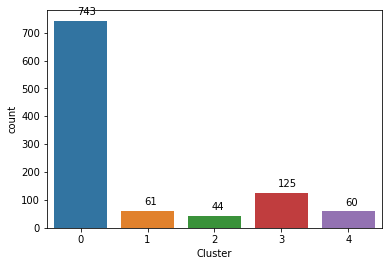

In [30]:
tfidf_cluster(sayori_tfidf, 5, sayori_df)

# Plot number of lines in each cluster
def plot_clusters(df):
    ax = sns.countplot(x="Cluster", data=df)

    for p in ax.patches:
            ax.annotate('{}'.format(p.get_height()), (p.get_x()+.35, p.get_height()+20))
            
plot_clusters(sayori_df)

The number of lines in each cluster is not a lot, but she has the shortest screen time. And she was later revealed to be depressed, despite her usual cheerful manners. Perhaps its why she has quite high number of clusters due to such a contrast.


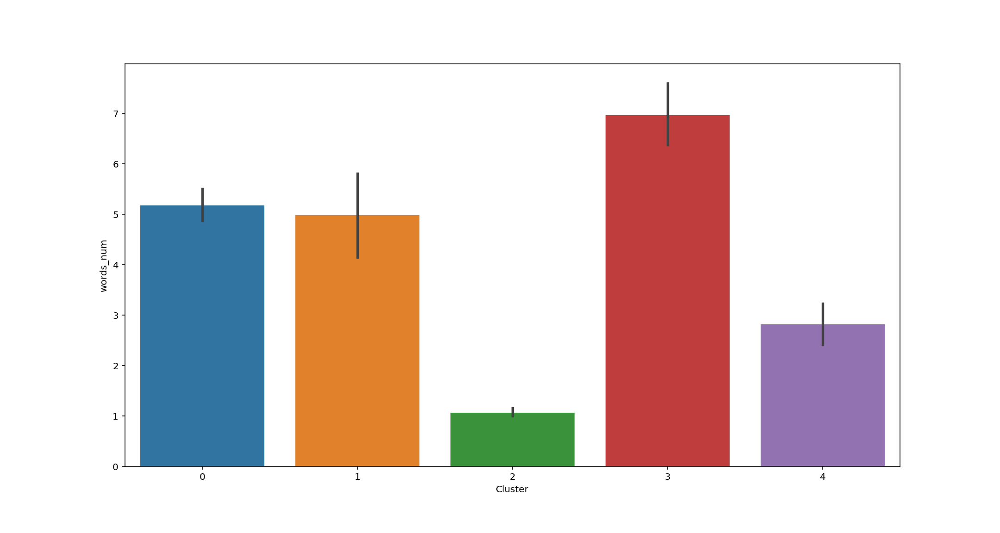
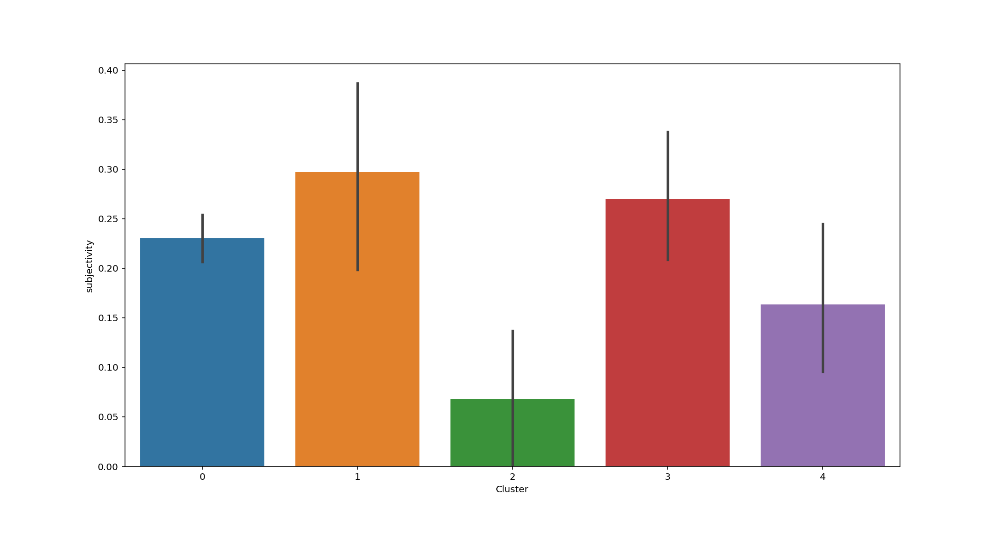
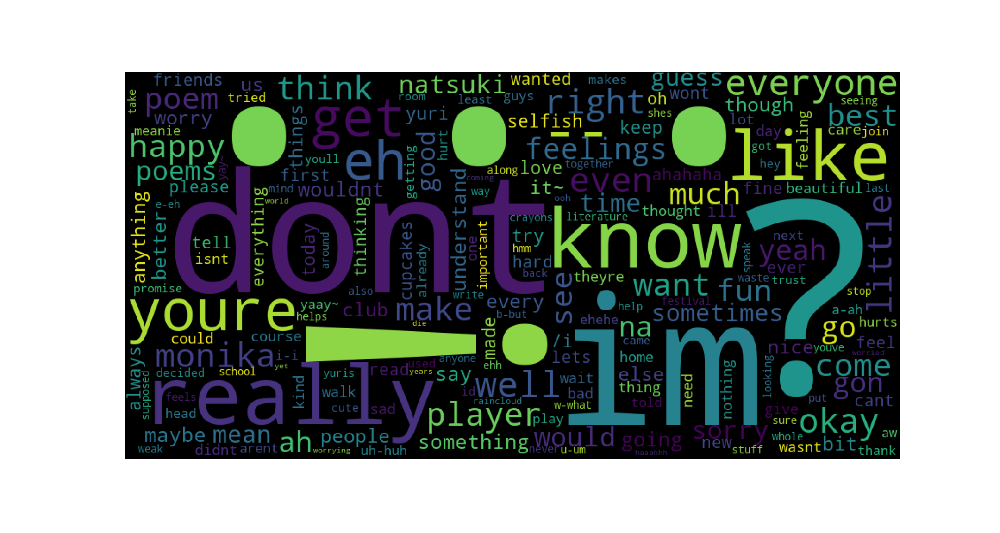
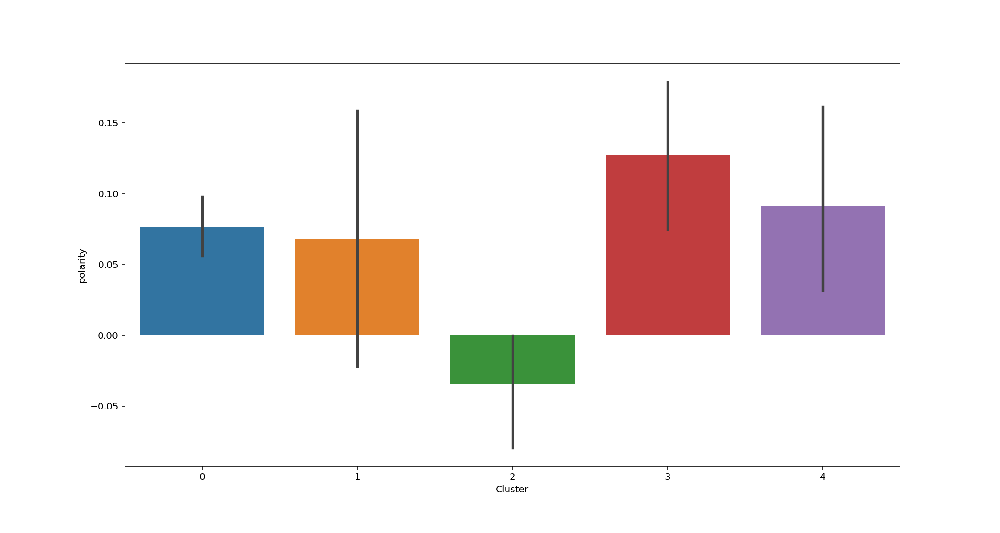
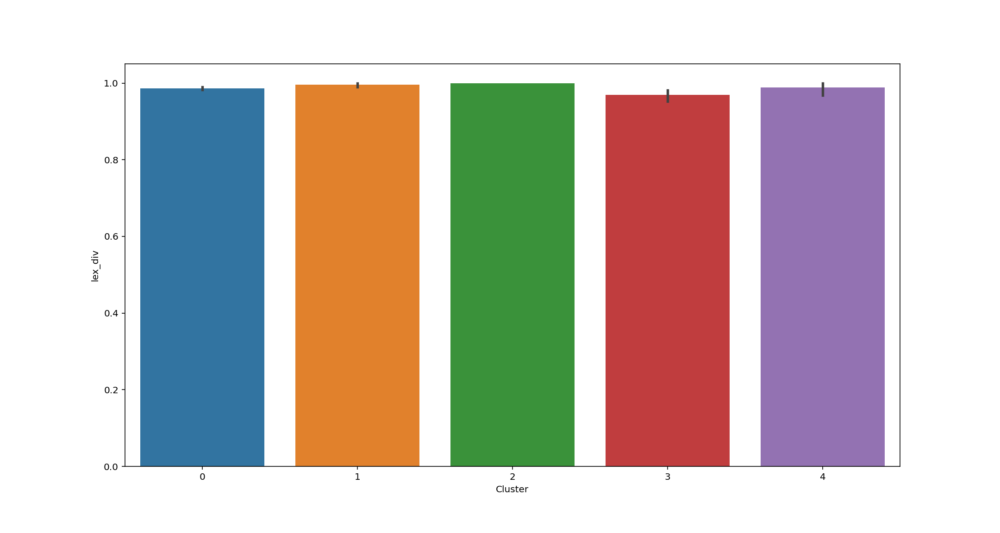
...
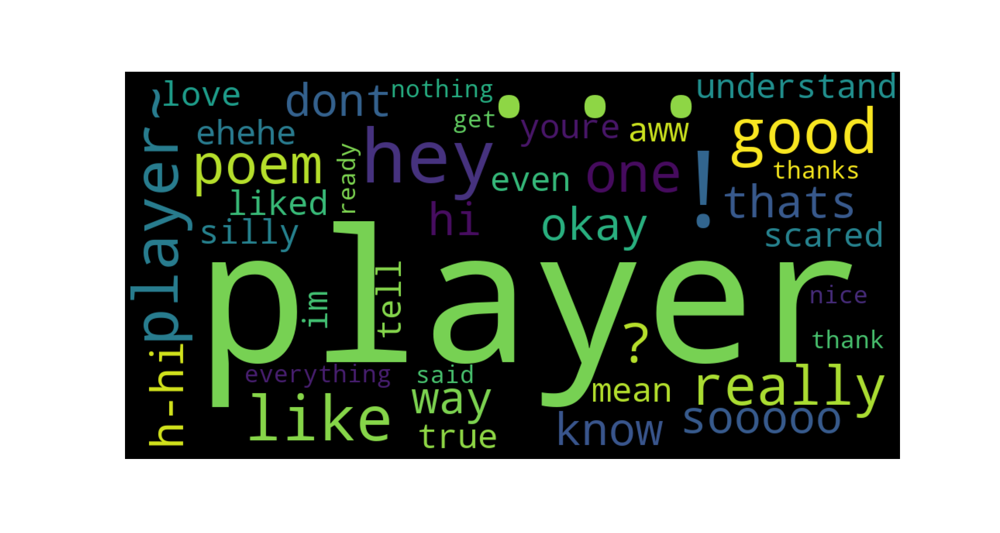
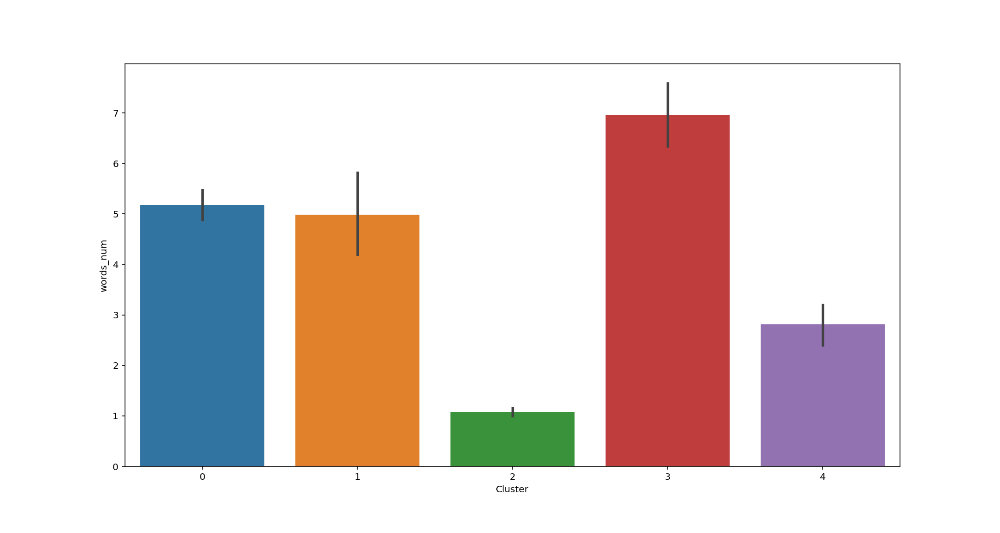
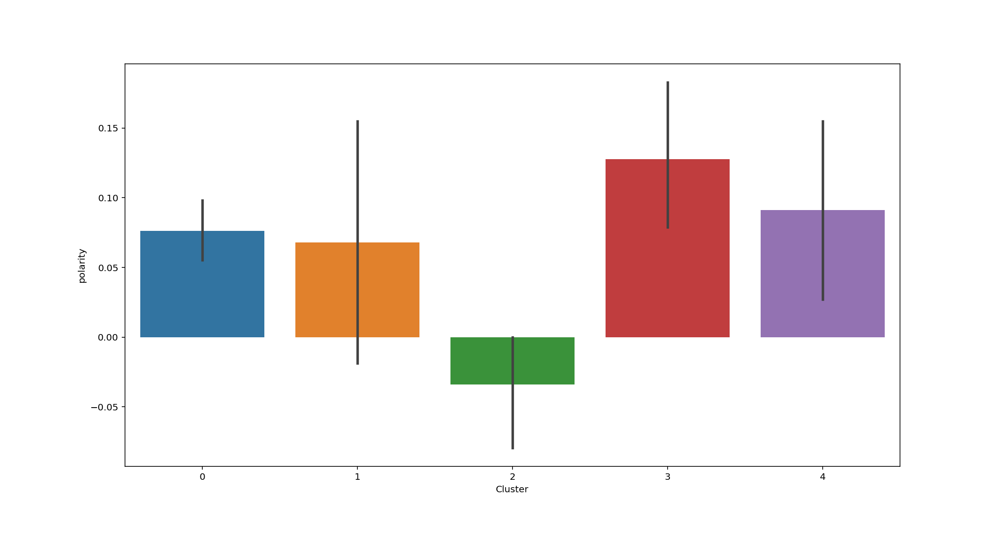
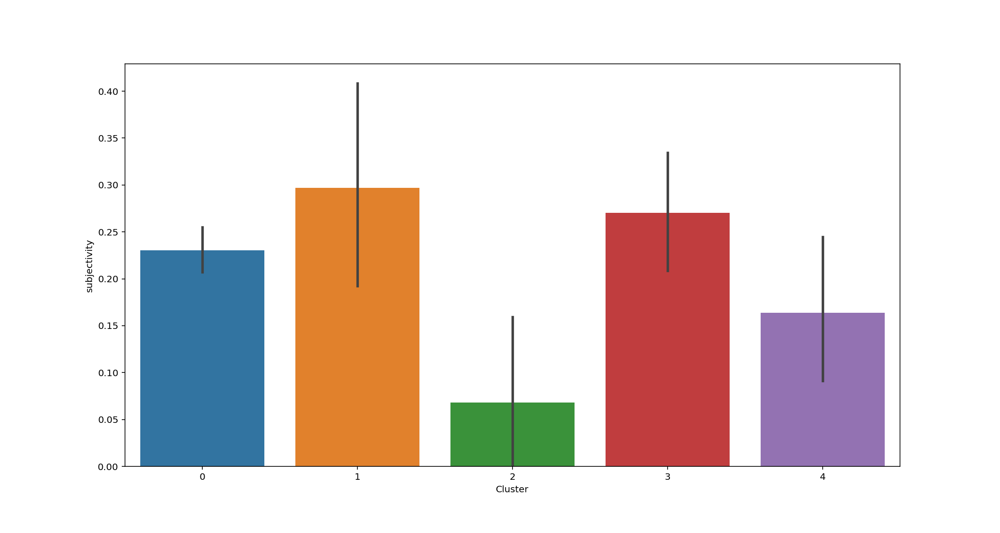
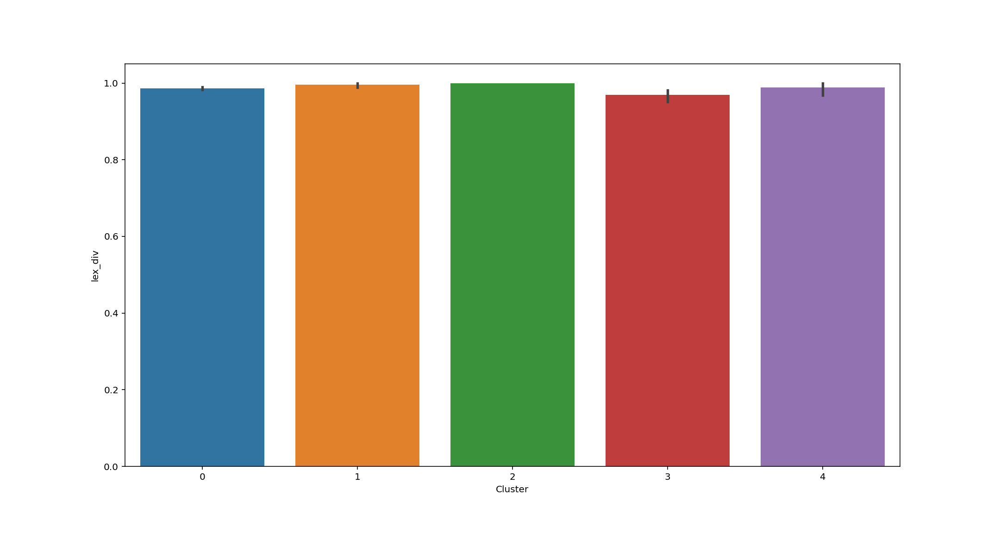

<Figure size 1200x800 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

In [31]:
# Create dashboard for each character
import param
import panel as pn
pn.extension()

temp_df = sayori_df
# I set the dropdown to 6, because the highest number of clusters for a character is 5
db_options = list(map(str,(sorted(list(range(0, 5))))))

class charDashboard(param.Parameterized):

    metric = param.ObjectSelector(default='0', objects=db_options)
    plt.figure(figsize=(12,8), dpi= 100)
    
#     Generate word cloud
    def cluster_to_wordcloud(self):
        plt.clf()
        filter_df = temp_df.loc[temp_df['Cluster'] == int(self.metric)]
        lists = filter_df['tokens'].to_list()
        counter = Counter([item for sublist in lists for item in sublist])
        wordcloud = WordCloud(width = 1000, height = 500, random_state=SEED).generate_from_frequencies(counter)

        plt.figure(figsize=(15,8))
        plt.imshow(wordcloud)
        plt.axis("off")
        return plt.gcf()
    
#     Show cluster vs. word number
    def cluster_word_num(self):
        plt.clf()
        ax = sns.barplot(x='Cluster', y='words_num', data=temp_df)
        return plt.gcf()
    
#     Show cluster vs. polarity
    def cluster_polarity(self):
        plt.clf()
        ax = sns.barplot(x='Cluster', y='polarity', data=temp_df)
        return plt.gcf()
    
#     Show cluster vs. subjectivity
    def cluster_subjectivity(self):
        plt.clf()
        ax = sns.barplot(x='Cluster', y='subjectivity', data=temp_df)
        return plt.gcf()
    
#     Show cluster vs. lexical diversity
    def cluster_lex_div(self):
        plt.clf()
        ax = sns.barplot(x='Cluster', y='lex_div', data=temp_df)
        return plt.gcf()

#     Clear the tabs
    def append_end(self):
        plt.clf()
        return ""
    
sayori_db = charDashboard(name='')

dashboard = pn.Column('Sayori Dashboard',
                      sayori_db.param,
                      pn.Tabs(
                          ('Word Cloud', sayori_db.cluster_to_wordcloud),
                          ('Words Number', sayori_db.cluster_word_num),
                          ('Polarity', sayori_db.cluster_polarity),
                          ('Subjectivity', sayori_db.cluster_subjectivity),
                          ('Lexcial Diversity', sayori_db.cluster_lex_div),
                          ('',sayori_db.append_end)
                      )
                     )

dashboard.embed()

Cluster 2 has the lowest word numbers, polarity and subjectivity and the words that are used are sorry etc. Cluster 3 has the highest polarity and the words are like happy, like etc.

## MC's clusters

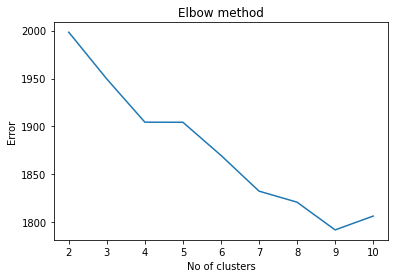

In [32]:
mc_df = filter_df_name("MC")
mc_tfidf = tokens_to_tfidf(mc_df)
plot_elbow(mc_tfidf)

Probably 4, as 7 and 9 are too many

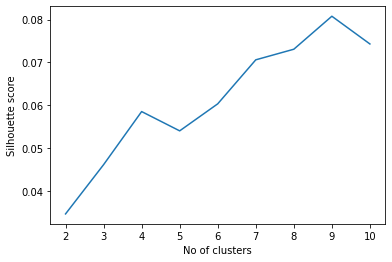

In [33]:
plot_silhouette()

Yes, 4 it is, since the increase is a lot from 3 to 4

C:\Users\tanke\AppData\Local\Temp/ipykernel_8436/1405964549.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Cluster'] = km.labels_.tolist()


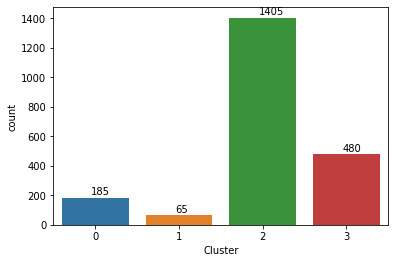

In [49]:
tfidf_cluster(mc_tfidf, 4, mc_df)
plot_clusters(mc_df)


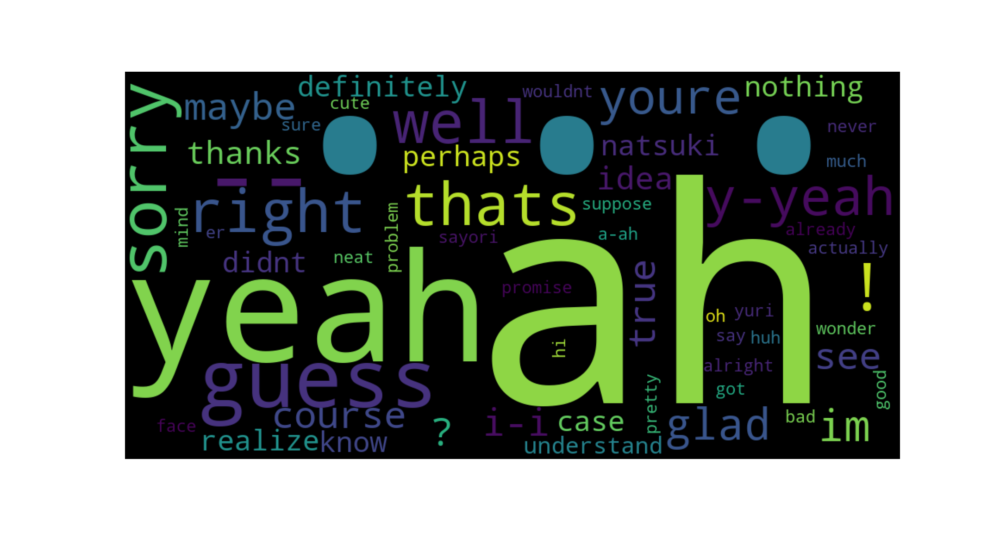
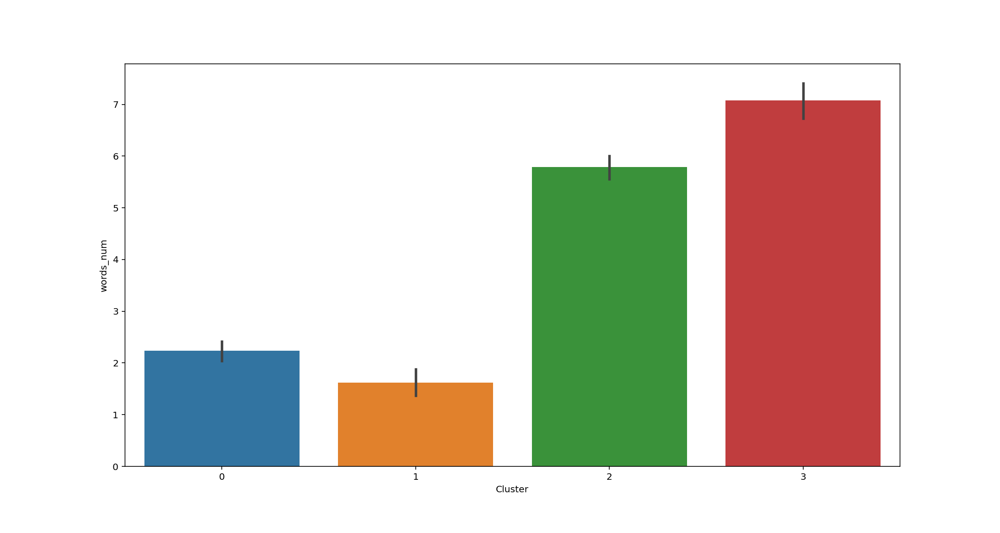
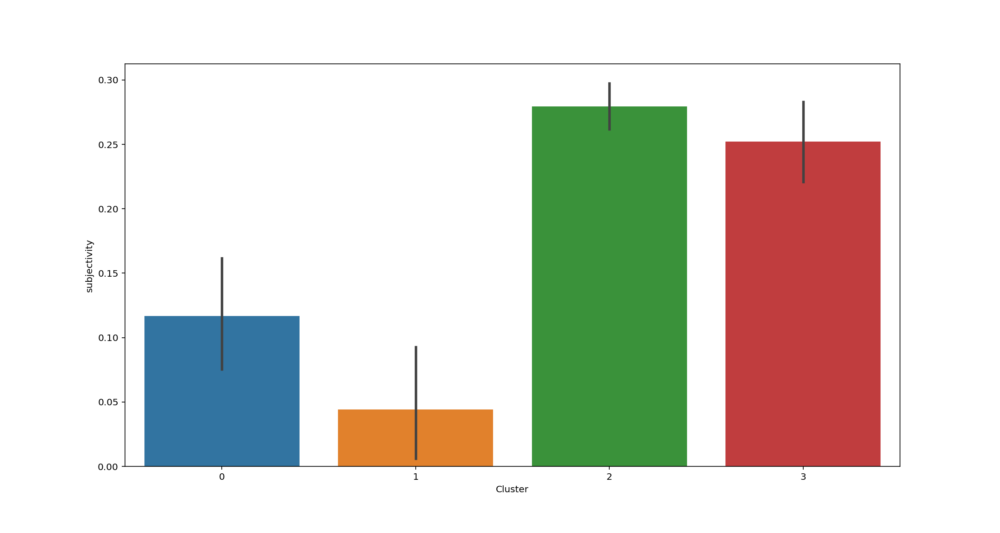
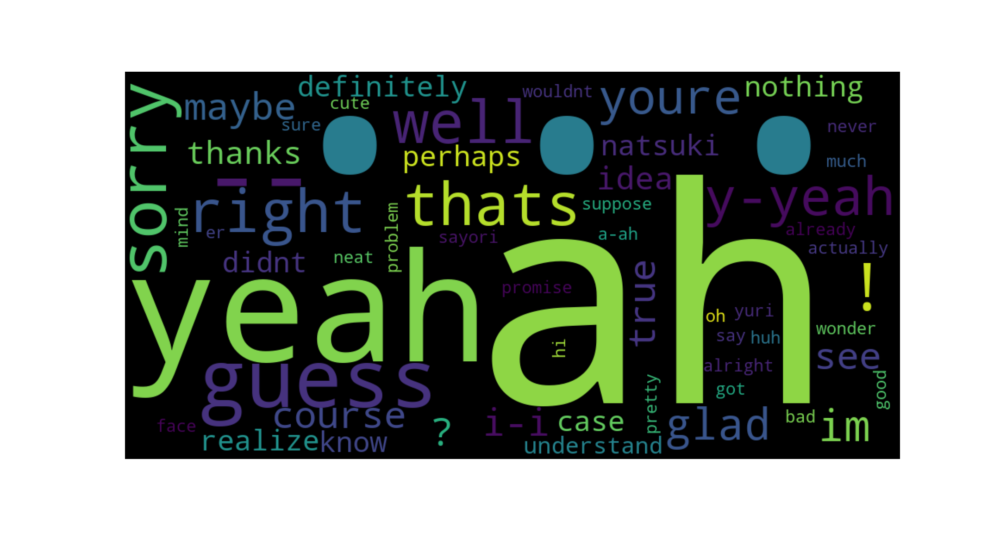
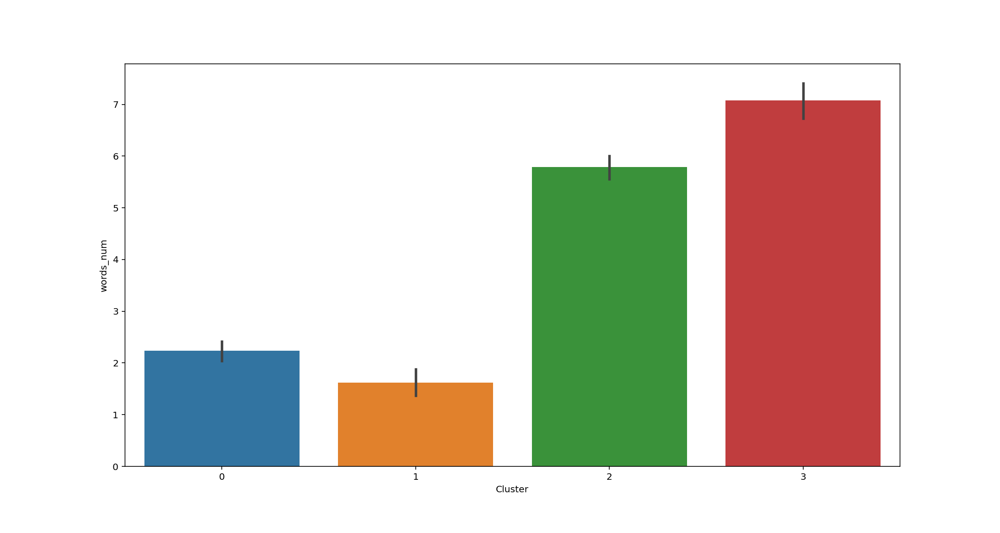
...
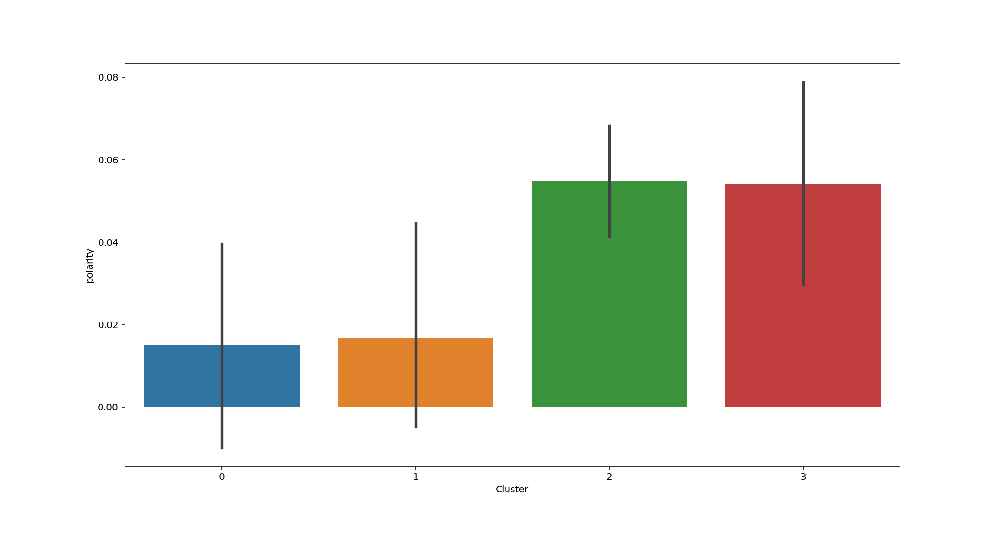
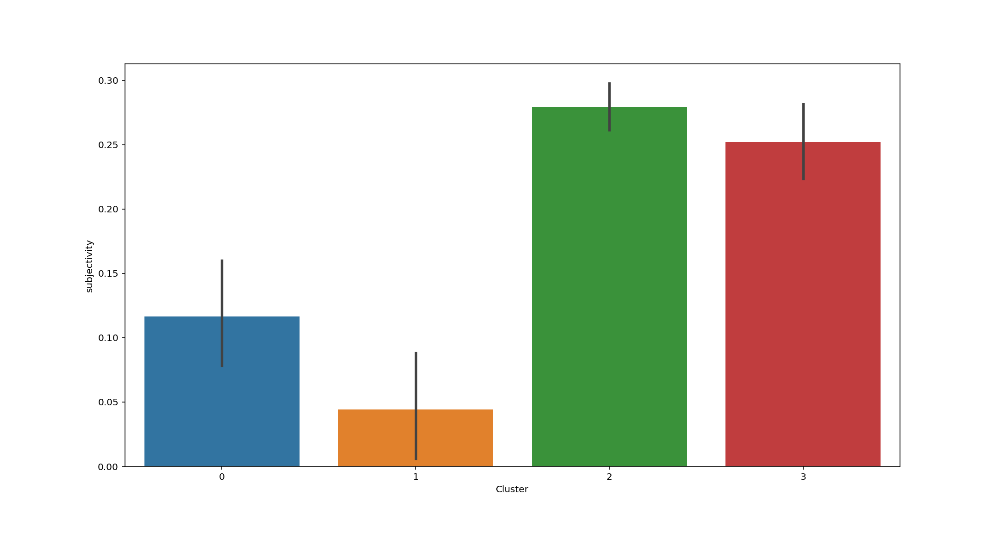
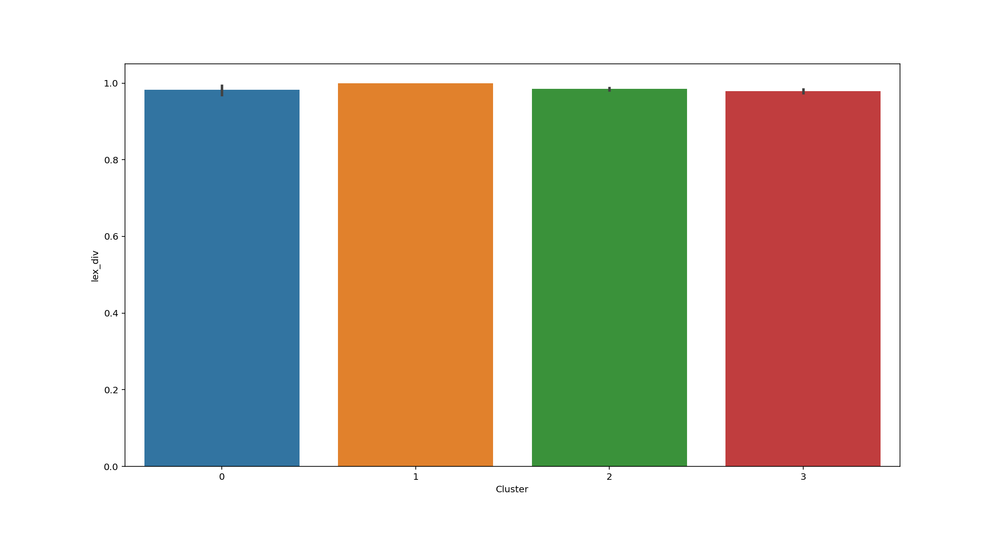
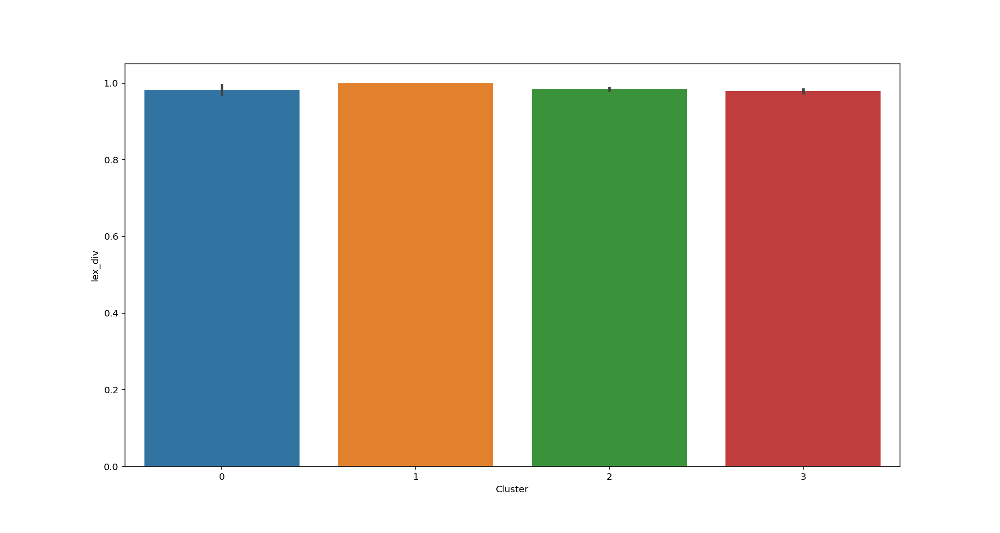
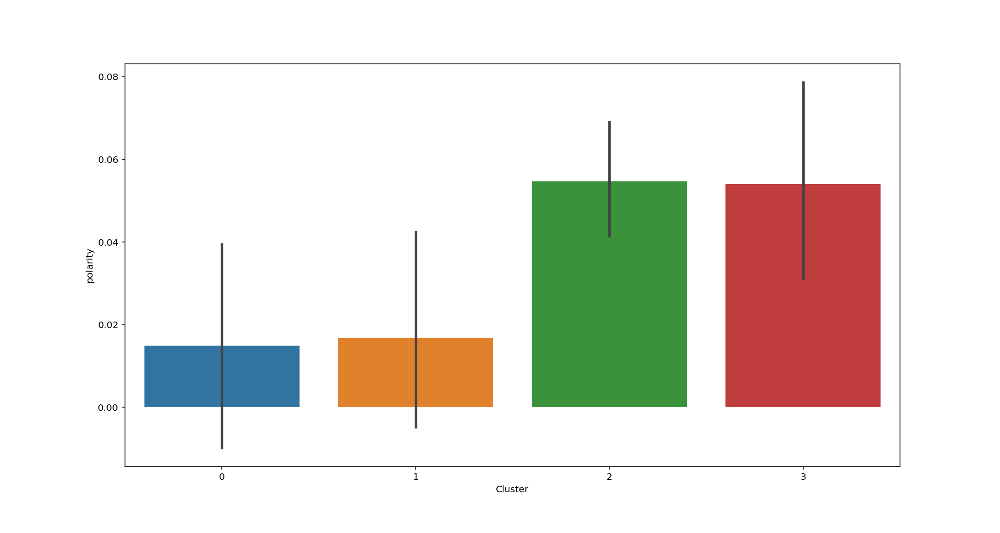

<Figure size 432x288 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

In [50]:
temp_df = mc_df
mc_db = charDashboard(name='')

dashboard = pn.Column('MC Dashboard',
                      mc_db.param,
                      pn.Tabs(
                          ('Word Cloud', mc_db.cluster_to_wordcloud),
                          ('Words Number', mc_db.cluster_word_num),
                          ('Polarity', mc_db.cluster_polarity),
                          ('Subjectivity', mc_db.cluster_subjectivity),
                          ('Lexcial Diversity', mc_db.cluster_lex_div),
                          ('',mc_db.append_end)
                      )
                     )

dashboard.embed()

Cluster 0 and 1 have the lowest polarity and lowest word numbers and the words are mainly fillers such as, maybe, sure and mean. Cluster 2 and 3 consists of mentions of other characters, mostly in a positive manner.

## Yuri's clusters

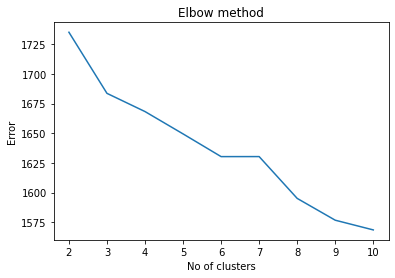

In [36]:
yuri_df = filter_df_name("Yuri")
yuri_tfidf = tokens_to_tfidf(yuri_df)
plot_elbow(yuri_tfidf)

3? 6 is probably too many.

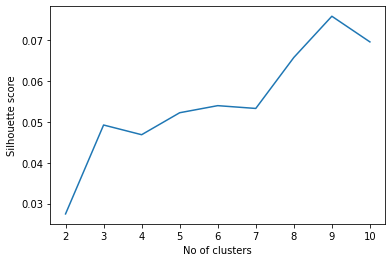

In [37]:
plot_silhouette()

Yup, 3, otherwise the increase is diminishing

C:\Users\tanke\AppData\Local\Temp/ipykernel_8436/1405964549.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Cluster'] = km.labels_.tolist()


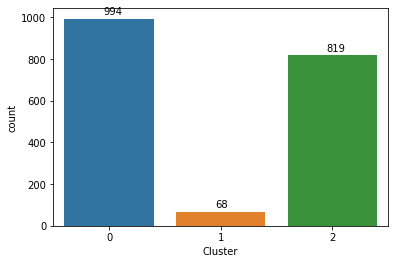

In [51]:
tfidf_cluster(yuri_tfidf, 3, yuri_df)
plot_clusters(yuri_df)


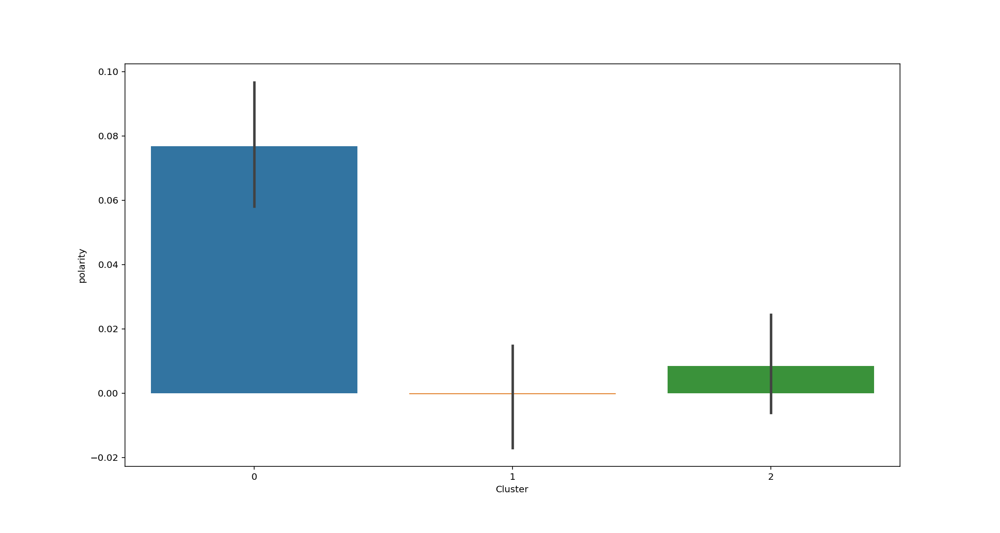
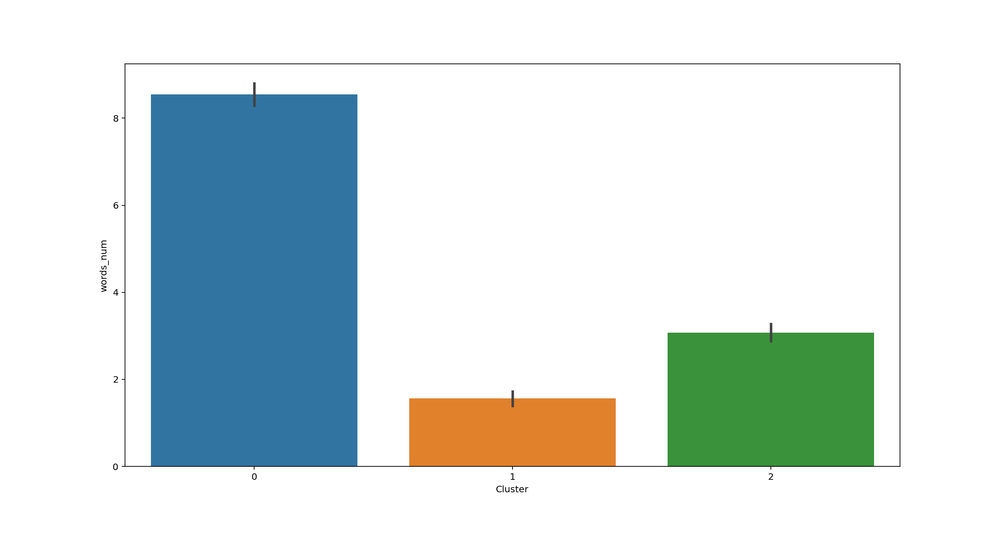
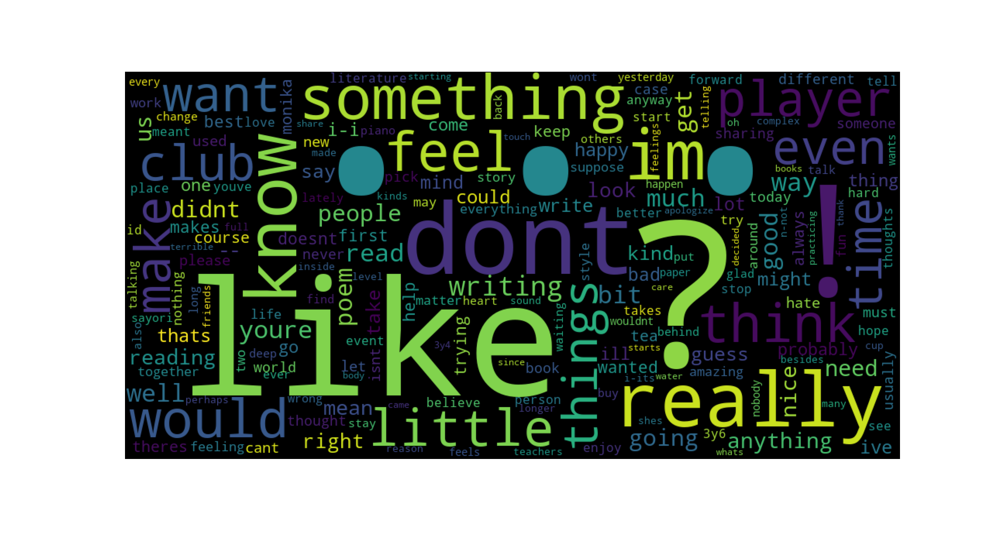
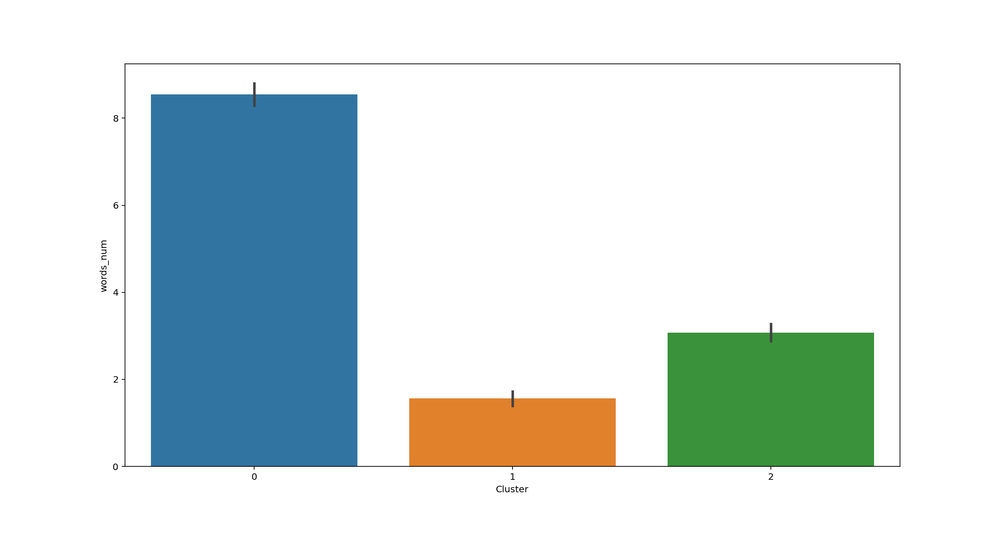
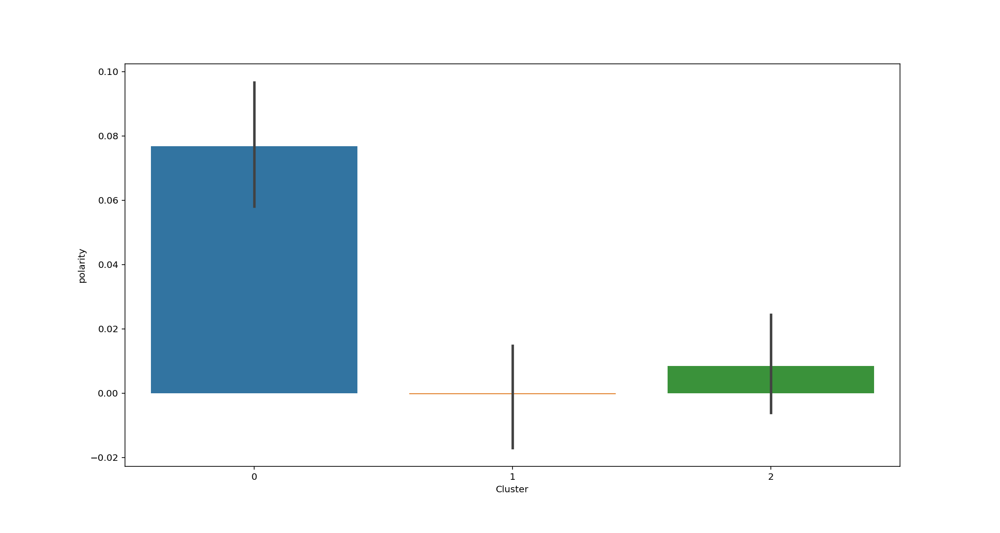
...
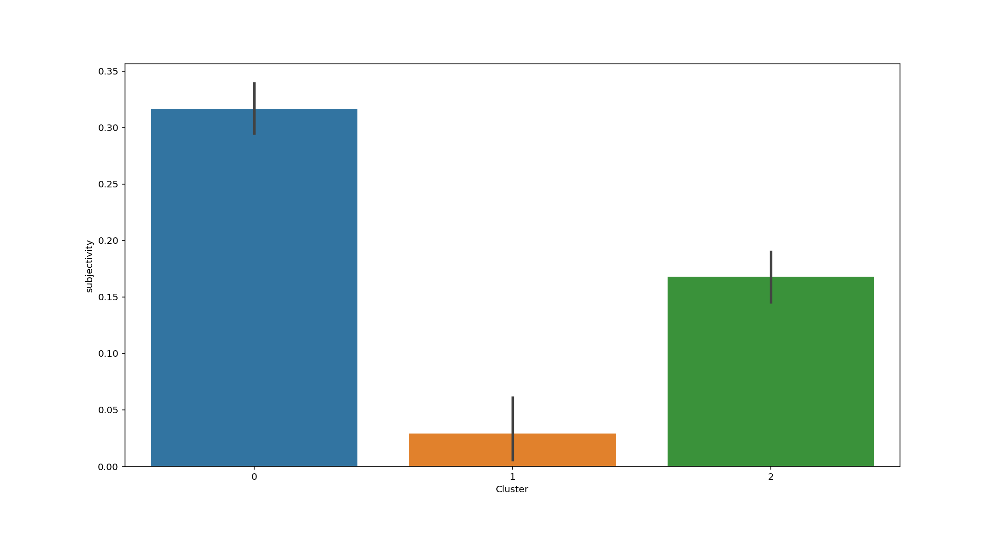
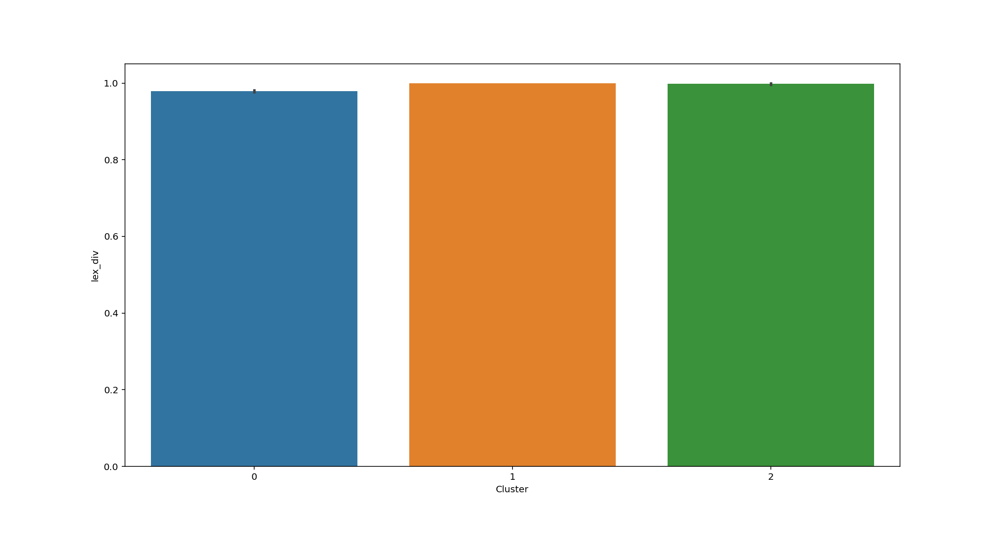
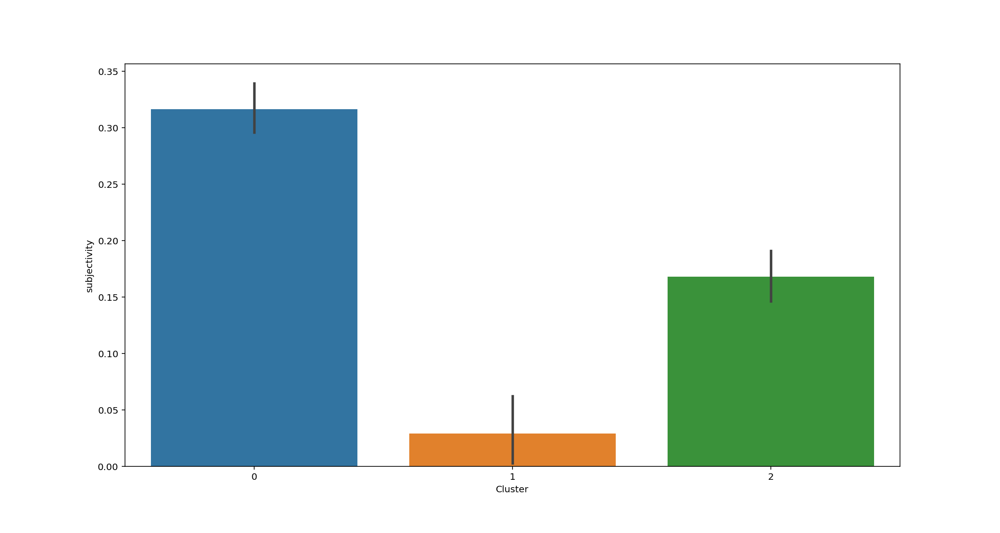
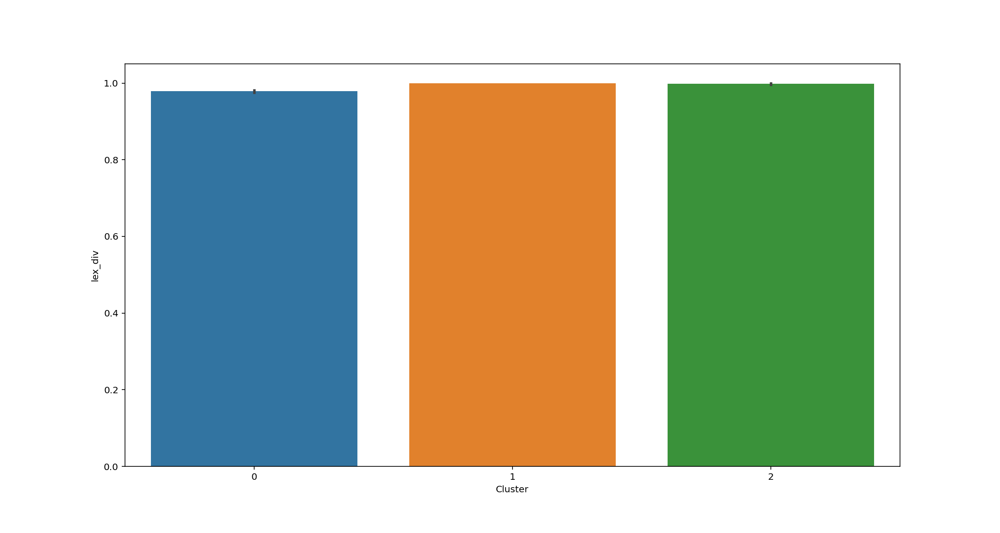
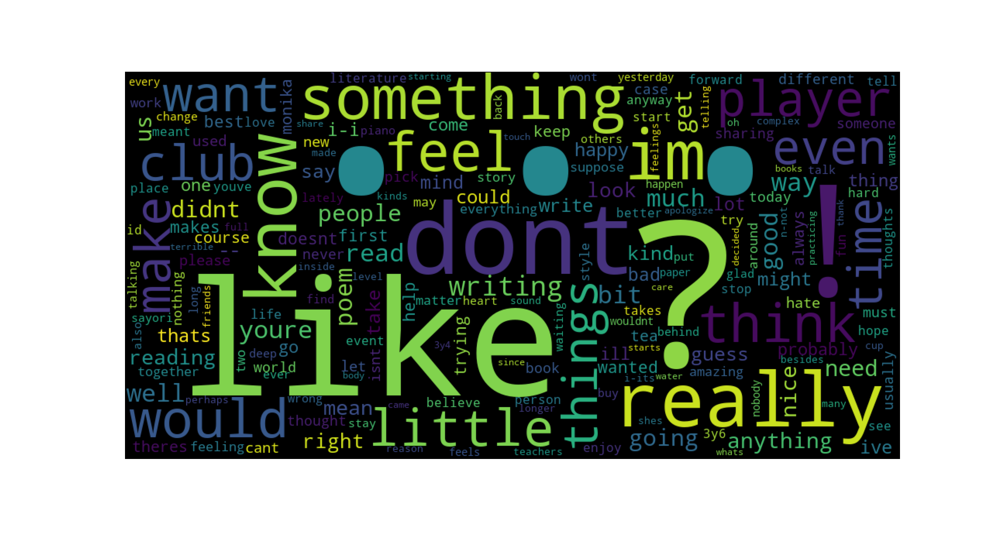

<Figure size 432x288 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

In [52]:
temp_df = yuri_df
yuri_db = charDashboard(name='')

dashboard = pn.Column('Yuri Dashboard',
                      yuri_db.param,
                      pn.Tabs(
                          ('Word Cloud', yuri_db.cluster_to_wordcloud),
                          ('Words Number', yuri_db.cluster_word_num),
                          ('Polarity', yuri_db.cluster_polarity),
                          ('Subjectivity', yuri_db.cluster_subjectivity),
                          ('Lexcial Diversity', yuri_db.cluster_lex_div),
                          ('',yuri_db.append_end)
                      )
                     )

dashboard.embed()

Cluster 1 has lowest polarity, subjectivity and number of words, it has mostly fillers such as mean, thanks, yeah. Cluster 0 has higher number of words, polarity and subjectivity than cluster 2. Interestingly, cluster 2 has more mentions of other characters, perhaps because she is the most introverted?

## Natsuki's clusters

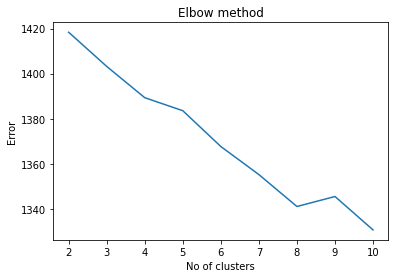

In [40]:
natsuki_df = filter_df_name("Natsuki")
natsuki_tfidf = tokens_to_tfidf(natsuki_df)
plot_elbow(natsuki_tfidf)

4? This is quite vague

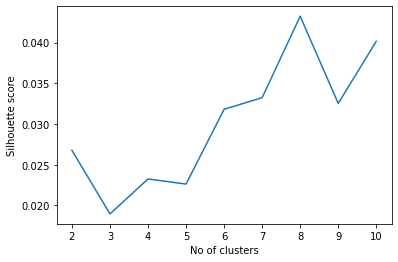

In [41]:
plot_silhouette()

4 looks ok

C:\Users\tanke\AppData\Local\Temp/ipykernel_8436/1405964549.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Cluster'] = km.labels_.tolist()


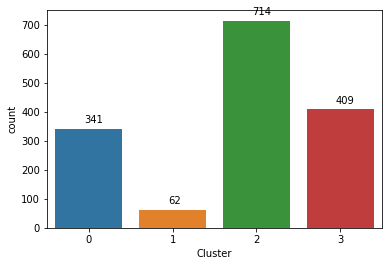

In [53]:
tfidf_cluster(natsuki_tfidf, 4, natsuki_df)
plot_clusters(natsuki_df)


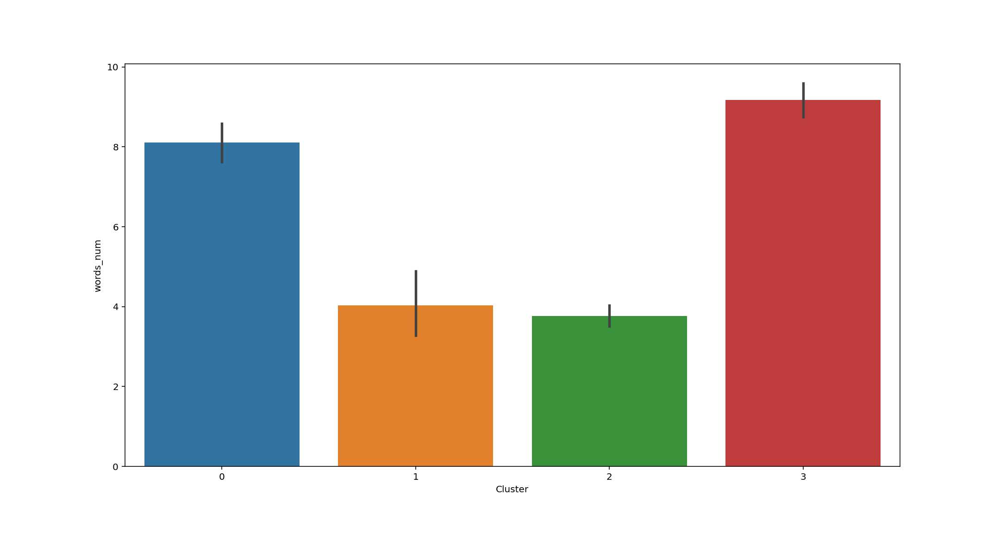
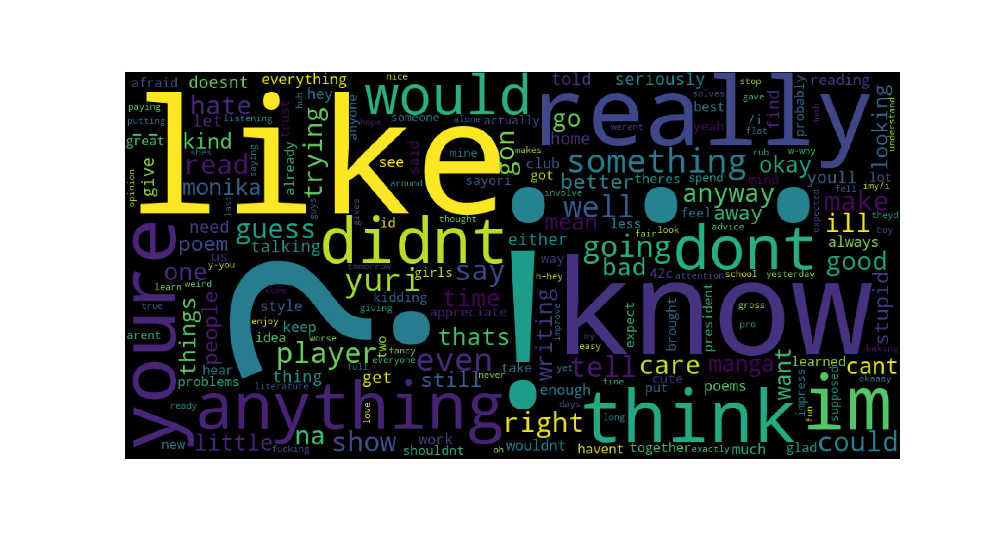
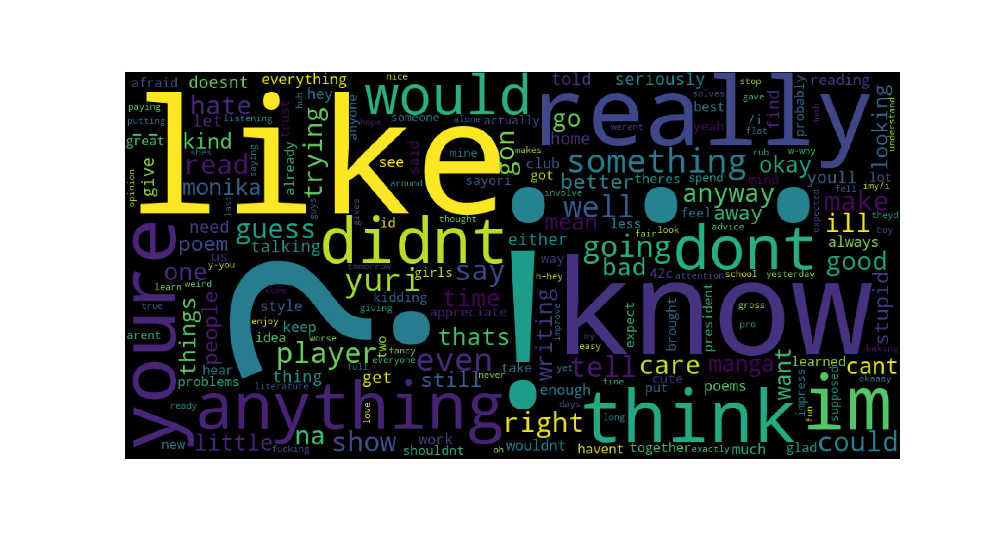
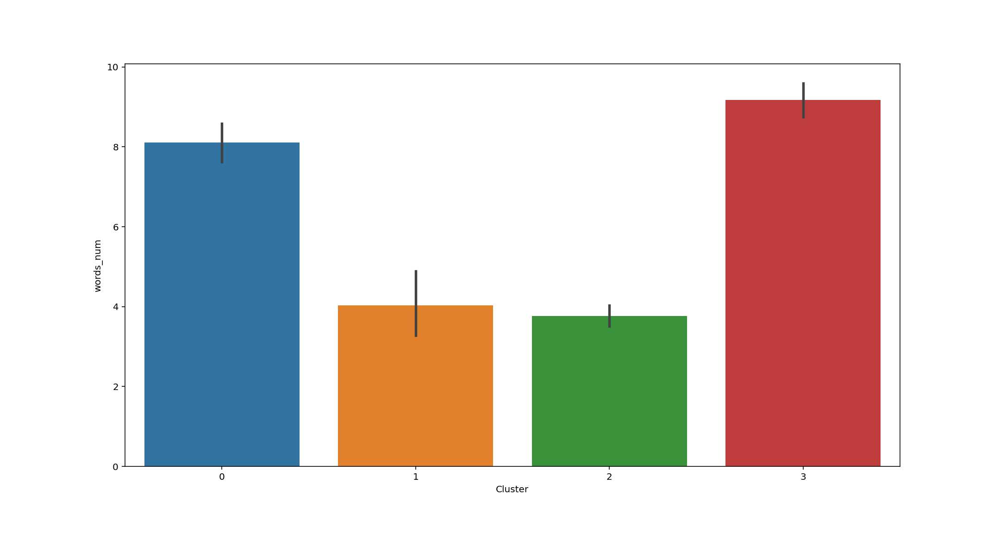
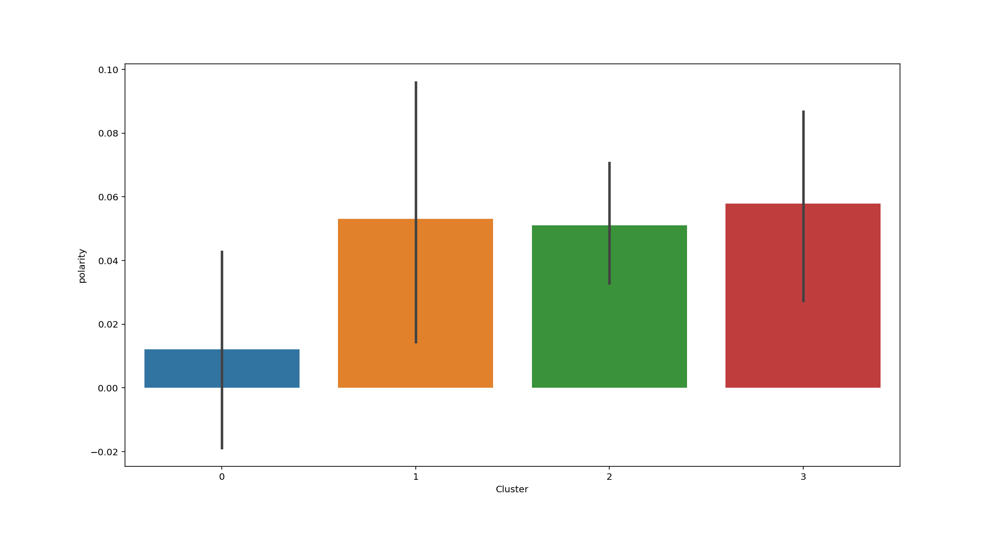
...
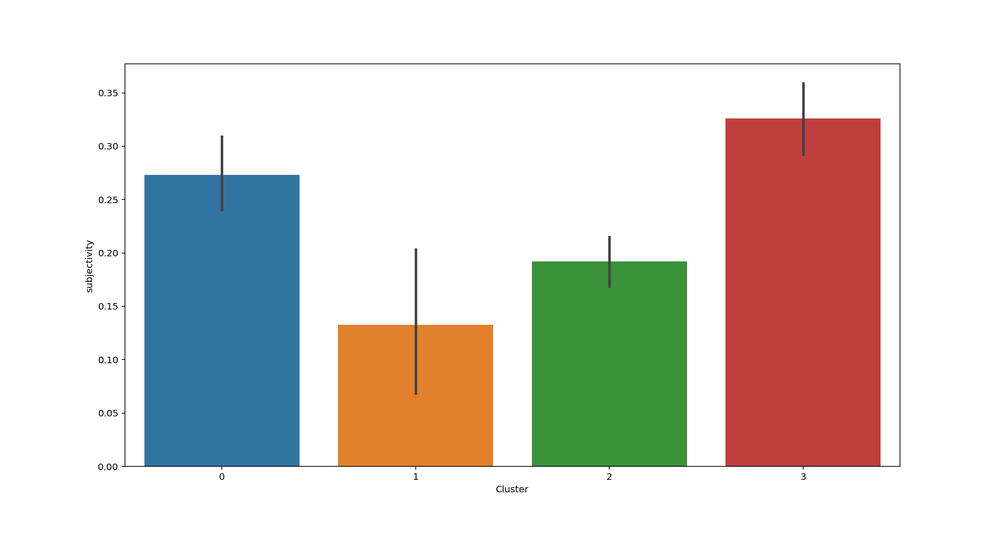
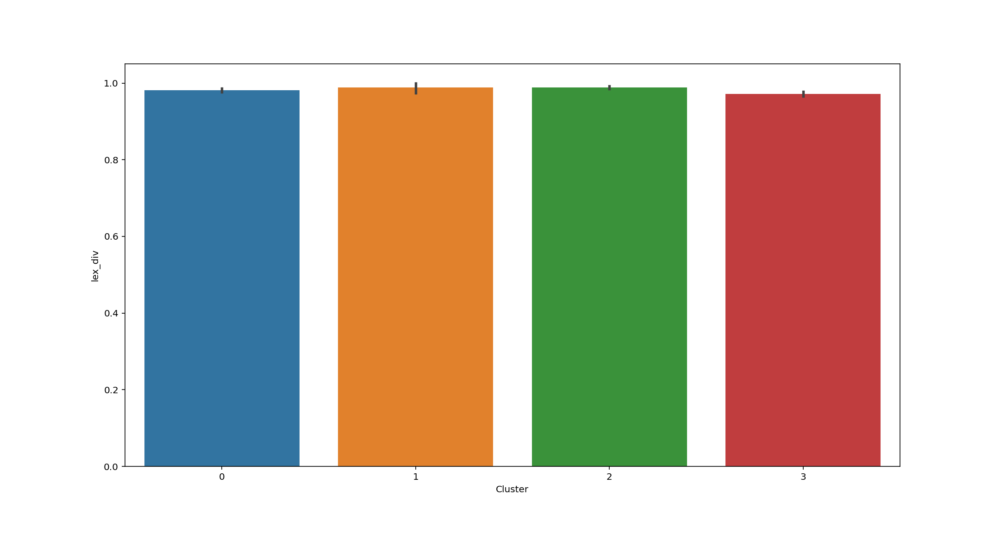
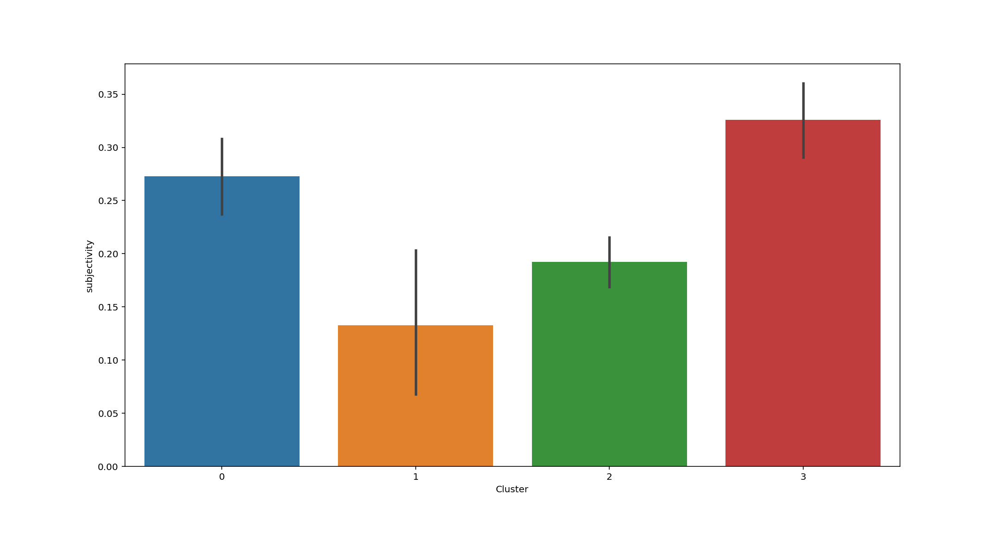
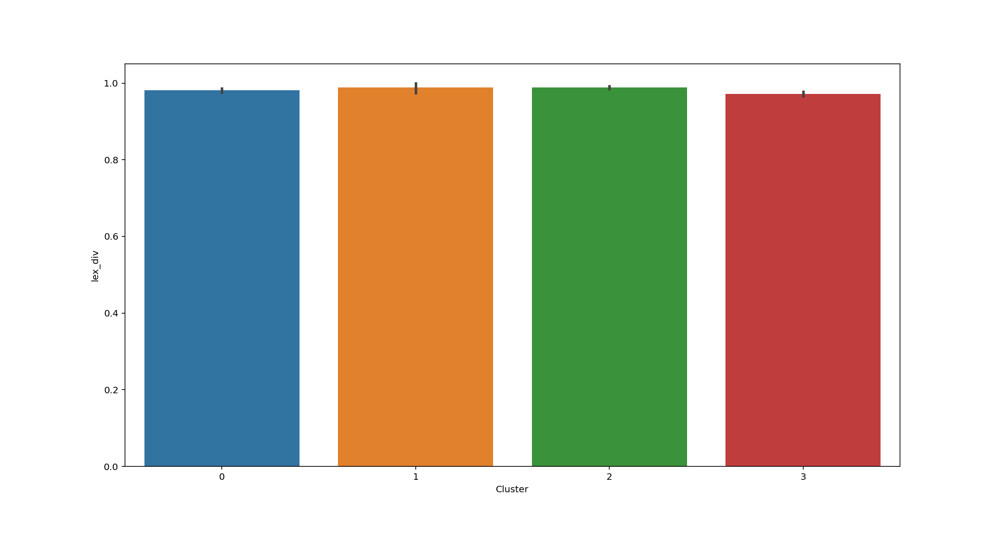
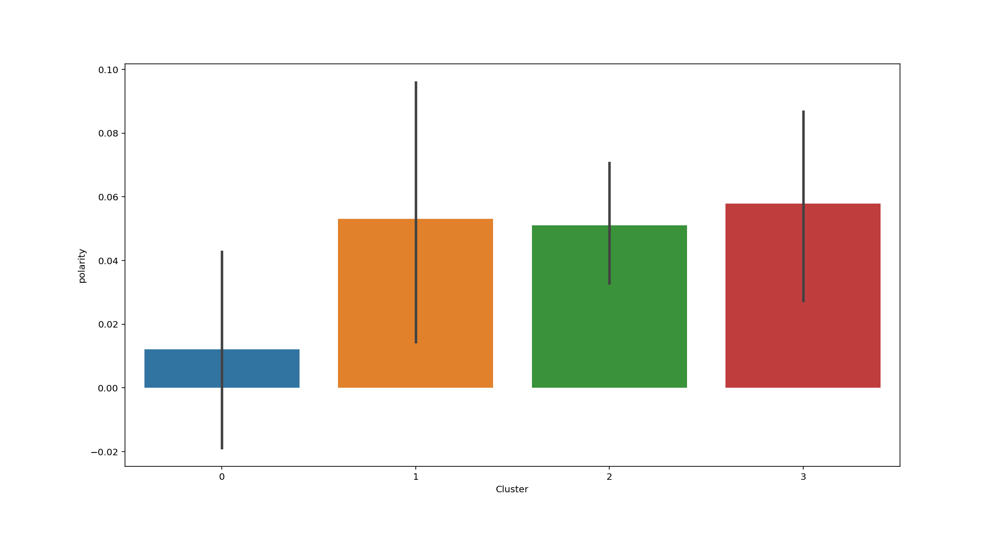

<Figure size 432x288 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

In [54]:
temp_df = natsuki_df
db_options = list(map(str,(sorted(temp_df['Cluster'].unique()))))
natsuki_db = charDashboard(name='')

dashboard = pn.Column('Natsuki Dashboard',
                      natsuki_db.param,
                      pn.Tabs(
                          ('Word Cloud', natsuki_db.cluster_to_wordcloud),
                          ('Words Number', natsuki_db.cluster_word_num),
                          ('Polarity', natsuki_db.cluster_polarity),
                          ('Subjectivity', natsuki_db.cluster_subjectivity),
                          ('Lexcial Diversity', natsuki_db.cluster_lex_div),
                          ('',natsuki_db.append_end)
                      )
                     )

dashboard.embed()

Cluster 0 has high number of words, but lowest polarity. It has a lot of third person plural verbs, such as know, like and think. These lines probably are when she is talking about herself. This is the opposite that what is found in Yuri.

## Monika's clusters

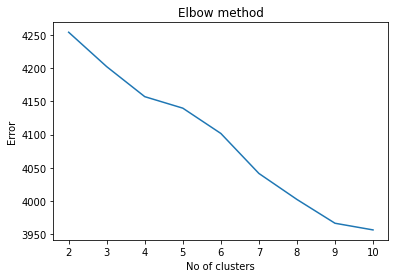

In [44]:
monika_df = filter_df_name("Monika")
monika_tfidf = tokens_to_tfidf(monika_df)
plot_elbow(monika_tfidf)

This is very vague, maybe 4?

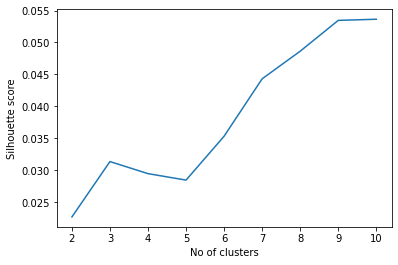

In [45]:
plot_silhouette()

Probably 3, since the increase is a lot

C:\Users\tanke\AppData\Local\Temp/ipykernel_8436/1405964549.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Cluster'] = km.labels_.tolist()


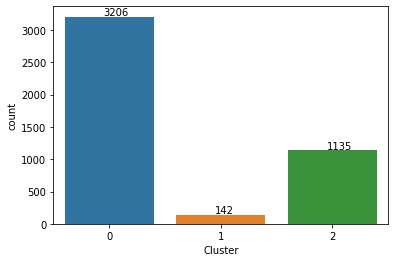

In [55]:
tfidf_cluster(monika_tfidf, 3, monika_df)
plot_clusters(monika_df)


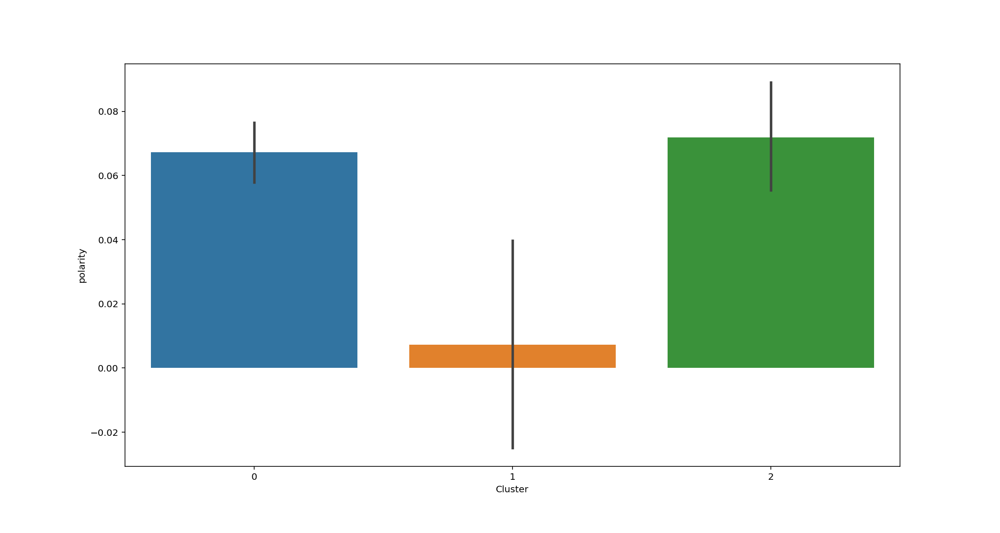
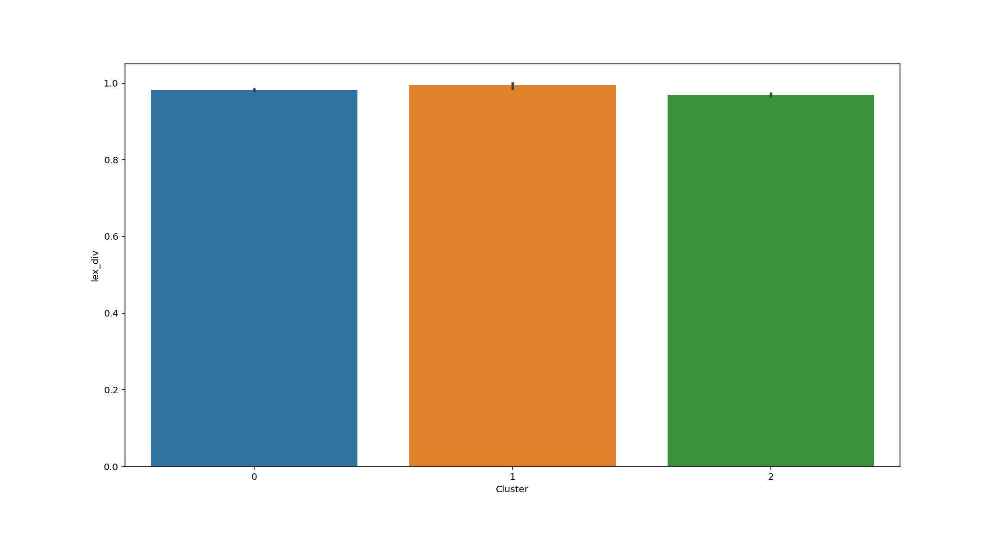
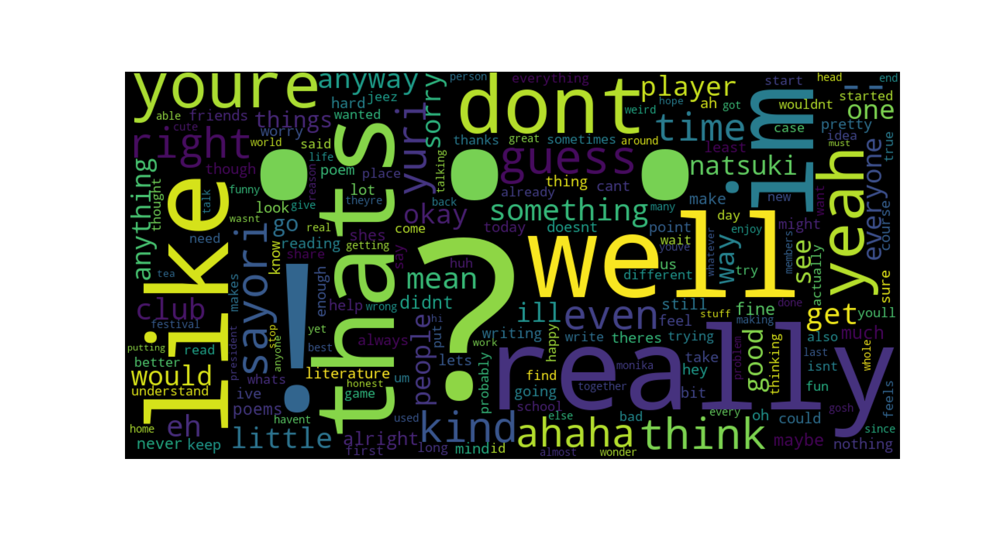
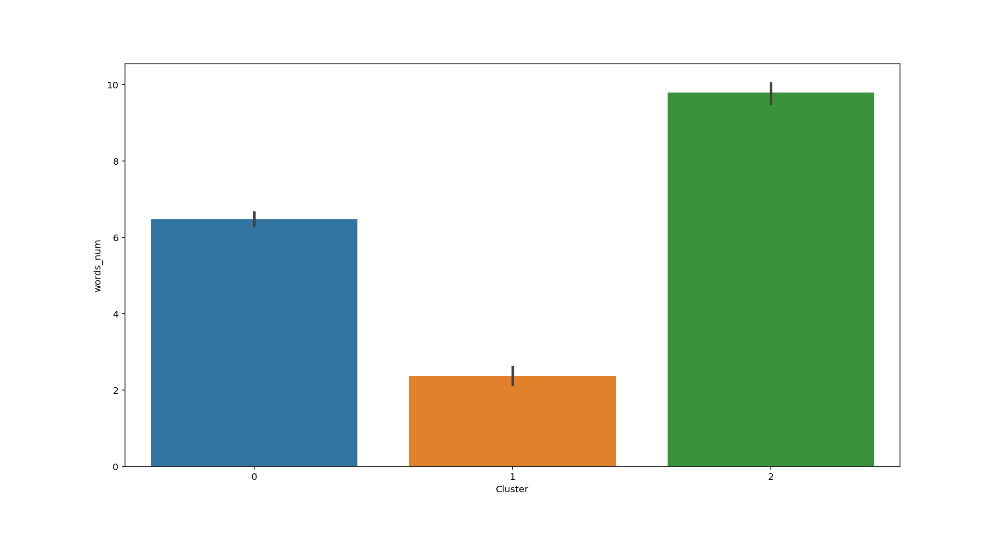
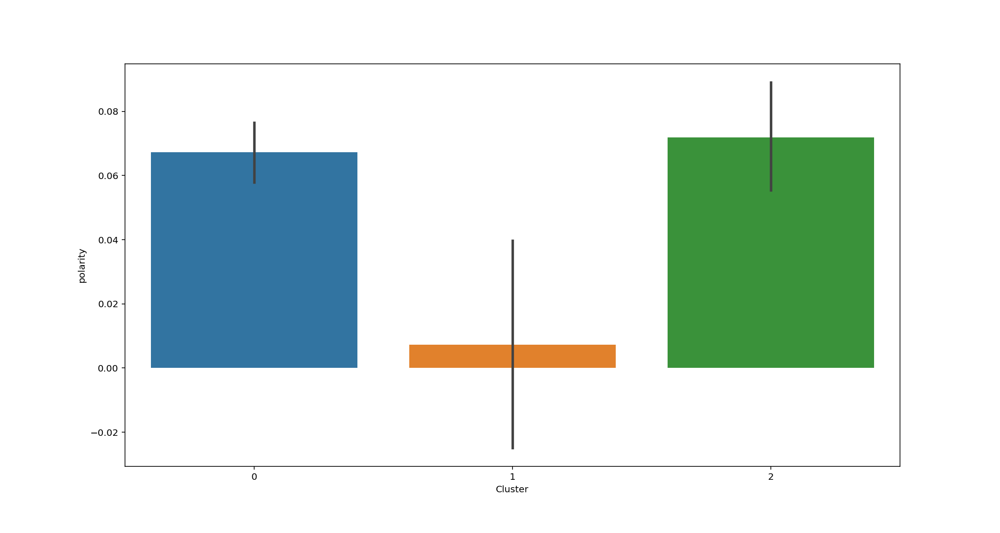
...
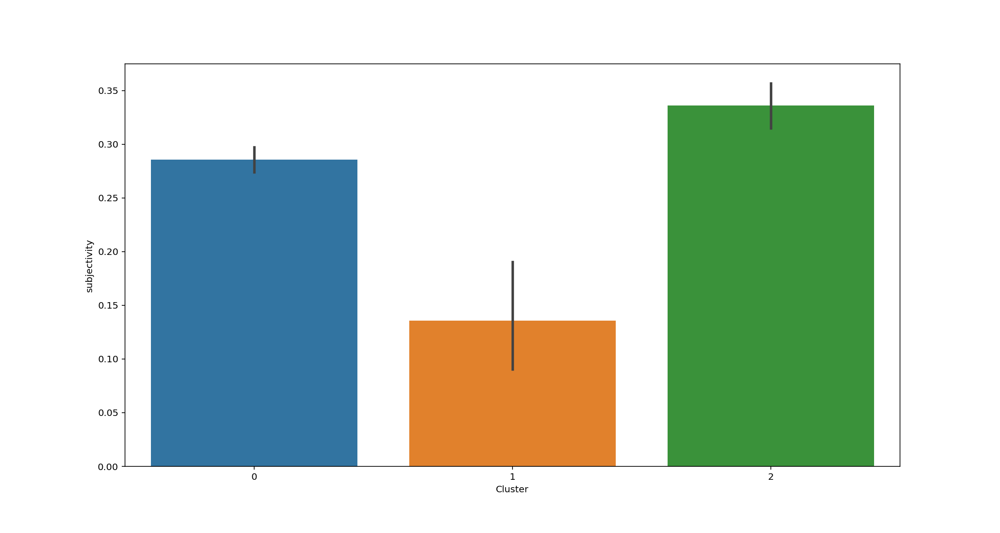
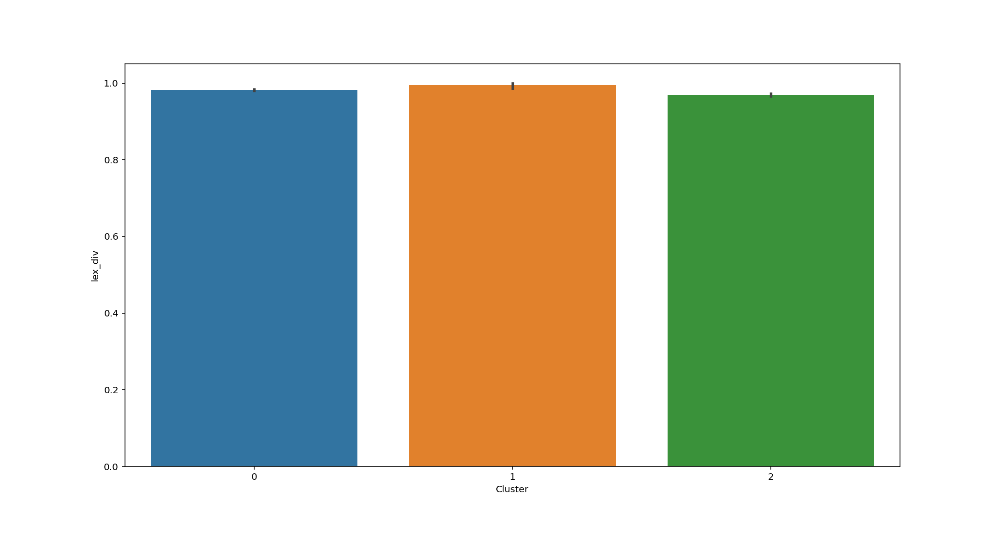
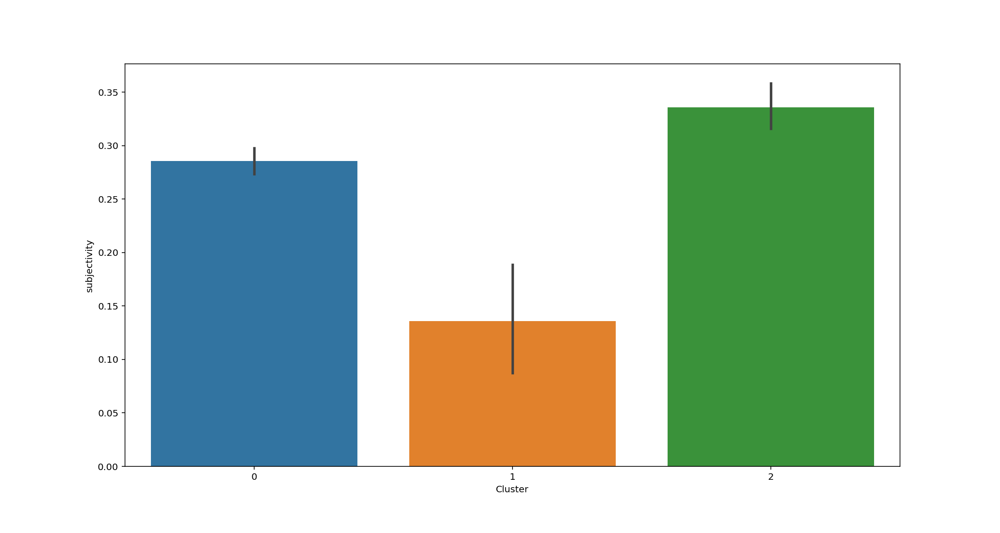
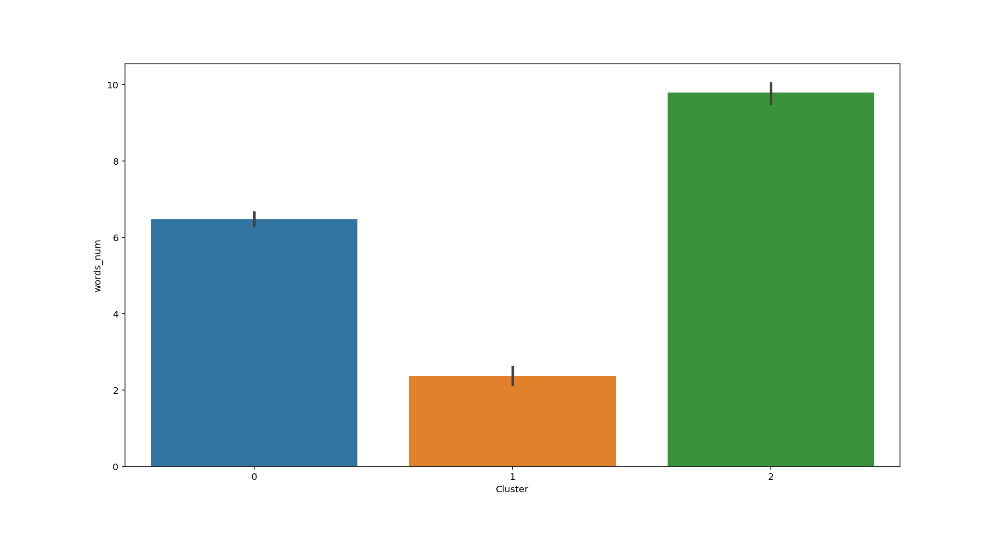
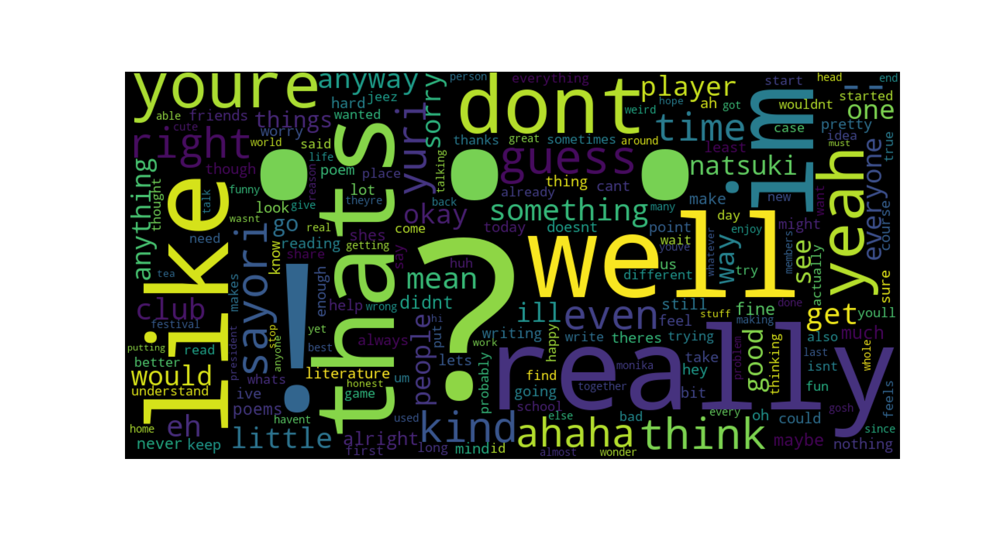

<Figure size 432x288 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

<Figure size 2160x1152 with 0 Axes>

In [56]:
temp_df = monika_df
db_options = list(map(str,(sorted(temp_df['Cluster'].unique()))))
monika_db = charDashboard(name='')

dashboard = pn.Column('Monika Dashboard',
                      monika_db.param,
                      pn.Tabs(
                          ('Word Cloud', monika_db.cluster_to_wordcloud),
                          ('Words Number', monika_db.cluster_word_num),
                          ('Polarity', monika_db.cluster_polarity),
                          ('Subjectivity', monika_db.cluster_subjectivity),
                          ('Lexcial Diversity', monika_db.cluster_lex_div),
                          ('',monika_db.append_end)
                      )
                     )

dashboard.embed()

Cluster 1 has the lowest number of words, polarity and subjectivity. It consists of fillers, such as well, really and also apology, like sorry. Cluster 0 has the second highest number of words and the most lines. As the club president, she mentions other members more often in this cluster and this cluster. As for cluster 2, it is mostly her opinions, likely about poems from members, as seen in the high number of words, subjectivity and polarity.

# Saving the dataframes as CSVs

In [48]:
df.to_csv("ddlc_scripts.csv", index=False)
sayori_df.to_csv("sayori_scripts.csv", index=False)
mc_df.to_csv("mc_scripts.csv", index=False)
yuri_df.to_csv("yuri_scripts.csv", index=False)
natsuki_df.to_csv("natsuki_scripts.csv", index=False)
monika_df.to_csv("monika_scripts.csv", index=False)